# Computer Vision Football Project

## GPU and dependencies

In [1]:
!nvidia-smi

Tue Sep  3 14:46:17 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
!pip install -q gdown inference-gpu
!pip install -q onnxruntime-gpu==1.18.0 --index-url https://aiinfra.pkgs.visualstudio.com/PublicPackages/_packaging/onnxruntime-cuda-12/pypi/simple/
!pip install -q git+https://github.com/roboflow/sports.git
!pip uninstall -y supervision
!pip install -q git+https://github.com/roboflow/supervision.git
!apt-get install -y ffmpeg


  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.8/619.8 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.1/148.1 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.0/906.0 kB 45.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.9/45.9 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 90.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 24.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 5.4 MB/s eta 0:00:00
   ━━

In [3]:
import os
os.environ["ONNXRUNTIME_EXECUTION_PROVIDERS"] = "[CUDAExecutionProvider]"

Download example videos from football matches

In [4]:
!gdown -O "0bfacc_0.mp4" "https://drive.google.com/uc?id=12TqauVZ9tLAv8kWxTTBFWtgt2hNQ4_ZF"
!gdown -O "2e57b9_0.mp4" "https://drive.google.com/uc?id=19PGw55V8aA6GZu5-Aac5_9mCy3fNxmEf"
!gdown -O "08fd33_0.mp4" "https://drive.google.com/uc?id=1OG8K6wqUw9t7lp9ms1M48DxRhwTYciK-"
!gdown -O "573e61_0.mp4" "https://drive.google.com/uc?id=1yYPKuXbHsCxqjA9G-S6aeR2Kcnos8RPU"
!gdown -O "121364_0.mp4" "https://drive.google.com/uc?id=1vVwjW1dE1drIdd4ZSILfbCGPD4weoNiu"

Downloading...
From: https://drive.google.com/uc?id=12TqauVZ9tLAv8kWxTTBFWtgt2hNQ4_ZF
To: /content/0bfacc_0.mp4
100% 19.9M/19.9M [00:00<00:00, 147MB/s]
Downloading...
From: https://drive.google.com/uc?id=19PGw55V8aA6GZu5-Aac5_9mCy3fNxmEf
To: /content/2e57b9_0.mp4
100% 21.1M/21.1M [00:00<00:00, 109MB/s] 
Downloading...
From: https://drive.google.com/uc?id=1OG8K6wqUw9t7lp9ms1M48DxRhwTYciK-
To: /content/08fd33_0.mp4
100% 19.9M/19.9M [00:00<00:00, 119MB/s] 
Downloading...
From: https://drive.google.com/uc?id=1yYPKuXbHsCxqjA9G-S6aeR2Kcnos8RPU
To: /content/573e61_0.mp4
100% 18.9M/18.9M [00:00<00:00, 23.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1vVwjW1dE1drIdd4ZSILfbCGPD4weoNiu
To: /content/121364_0.mp4
100% 17.2M/17.2M [00:00<00:00, 96.0MB/s]


## Imports and auxiliary functions

In [5]:
from inference import get_model
from google.colab import userdata
import supervision as sv
import cv2
from tqdm import tqdm
from IPython.display import HTML
from base64 import b64encode
import pandas as pd
import numpy as np
import torch
from transformers import AutoProcessor, SiglipVisionModel
from more_itertools import chunked
import umap
from sklearn.cluster import KMeans
from sports.configs.soccer import SoccerPitchConfiguration
from sports.common.view import ViewTransformer
from sports.common.team import TeamClassifier
from sports.annotators.soccer import (
    draw_pitch,
    draw_points_on_pitch
)
from collections import deque
from typing import List, Union
from sports.annotators.soccer import draw_paths_on_pitch
import matplotlib.pyplot as plt
from collections import defaultdict


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


In [6]:
# Function to convert output video frames to video
def save_video(output_video_frames, output_video_path):
    fourcc = cv2.VideoWriter_fourcc(*'XVID')  # Guardar en formato AVI
    out = cv2.VideoWriter(output_video_path, fourcc, 24, (output_video_frames[0].shape[1], output_video_frames[0].shape[0]))
    for frame in output_video_frames:
        out.write(frame)
    out.release()

In [7]:
def infer_model(SOURCE_VIDEO_PATH):
    tracker = sv.ByteTrack()
    tracker.reset()

    frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
    all_detections_list = []

    ball_detections_list = []

    for frame in tqdm(frame_generator, desc='infering model'):
        frame = frame.copy()
        result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
        detections = sv.Detections.from_inference(result)
        ball_detections = detections[detections.class_id == BALL_ID]
        ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)
        ball_detections_list.append(ball_detections)

        all_detections = detections[detections.class_id != BALL_ID]
        all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
        all_detections.class_id -= 1
        all_detections = tracker.update_with_detections(detections=all_detections)
        all_detections_list.append(all_detections)

    print("")
    print("Done!")
    return all_detections_list, ball_detections_list

In [8]:
def annotate_frame(frame, all_detections, ball_detections):
    labels = [
        f"#{tracker_id}"
        for tracker_id
        in all_detections.tracker_id
    ]

    annotated_frame = frame.copy()
    annotated_frame = ellipse_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections,
        labels=labels)
    annotated_frame = triangle_annotator.annotate(
        scene=annotated_frame,
        detections=ball_detections)

    return annotated_frame


In [9]:
def interpolate_ball_positions(ball_positions):
    ball_positions = [x.get(1, {}).get('bbox', []) for x in ball_positions]
    df_ball_positions = pd.DataFrame(ball_positions, columns=['x1', 'y1', 'x2', 'y2'])

    # Interpolar valores faltantes
    df_ball_positions = df_ball_positions.interpolate()
    df_ball_positions = df_ball_positions.bfill()

    ball_positions = [{1: {"bbox": x}} for x in df_ball_positions.to_numpy().tolist()]

    return ball_positions

In [10]:
def resolve_goalkeepers_team_id(
    players: sv.Detections,
    goalkeepers: sv.Detections
) -> np.ndarray:
    goalkeepers_xy = goalkeepers.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    players_xy = players.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    team_0_centroid = players_xy[players.class_id == 0].mean(axis=0)
    team_1_centroid = players_xy[players.class_id == 1].mean(axis=0)
    goalkeepers_team_id = []
    for goalkeeper_xy in goalkeepers_xy:
        dist_0 = np.linalg.norm(goalkeeper_xy - team_0_centroid)
        dist_1 = np.linalg.norm(goalkeeper_xy - team_1_centroid)
        goalkeepers_team_id.append(0 if dist_0 < dist_1 else 1)

    return np.array(goalkeepers_team_id)

In [11]:
def team_color_detection(players_detections, player_crops):
    # Step 5: Extract top half of player crops for color analysis
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
    players_top_half_crops = [crop[:crop.shape[0]//2, :] for crop in players_crops]

    # Step 6: Use KMeans to cluster player colors and determine team colors
    player_colors = []
    for i, top_half_crop in enumerate(players_top_half_crops):
        kmeans = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=1).fit(top_half_crop.reshape(-1, 3))

        labels = kmeans.labels_.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

        corner_clusters = [
            labels[0, 0], labels[0, -1], labels[-1, 0], labels[-1, -1]
        ]
        non_player_cluster = max(set(corner_clusters), key=corner_clusters.count)
        player_cluster = 1 - non_player_cluster

        player_color = kmeans.cluster_centers_[player_cluster]
        player_colors.append(player_color)

    # Step 7: Classify players into two teams using KMeans
    kmeans_2 = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=10).fit(player_colors)
    team_ids = [int(kmeans_2.predict(color.reshape(1, -1))[0]) for color in player_colors]


    # Step 9: Extract team colors and prepare for annotation
    team_colors_bgr = kmeans_2.cluster_centers_.astype(int)

    def rgb2hex(r, g, b):
        return "#{:02x}{:02x}{:02x}".format(r, g, b)

    # Convert RGB to HEX
    team_colors_hex = [rgb2hex(color[2], color[1], color[0]) for color in team_colors_bgr]

    return team_colors_hex

In [12]:
CONFIG = SoccerPitchConfiguration()

## Ball, Player, Goalkeeper, Referee Detector

Declare the Roboflow API key and the model to use. We can use a pretrained model from roboflow or we can train a new model using this [notebook](https://colab.research.google.com/drive/11Vhs3h1IDw8dwkFHHw65ju4FANOKmuqK?usp=sharing).

In [13]:
ROBOFLOW_API_KEY = userdata.get('ROBOFLOW_API_KEY')
PLAYER_DETECTION_MODEL_ID = "football-players-detection-3zvbc/11"
PLAYER_DETECTION_MODEL = get_model(model_id=PLAYER_DETECTION_MODEL_ID, api_key=ROBOFLOW_API_KEY)

Choose the video we want to use the model with

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

Plot the first frame of the video

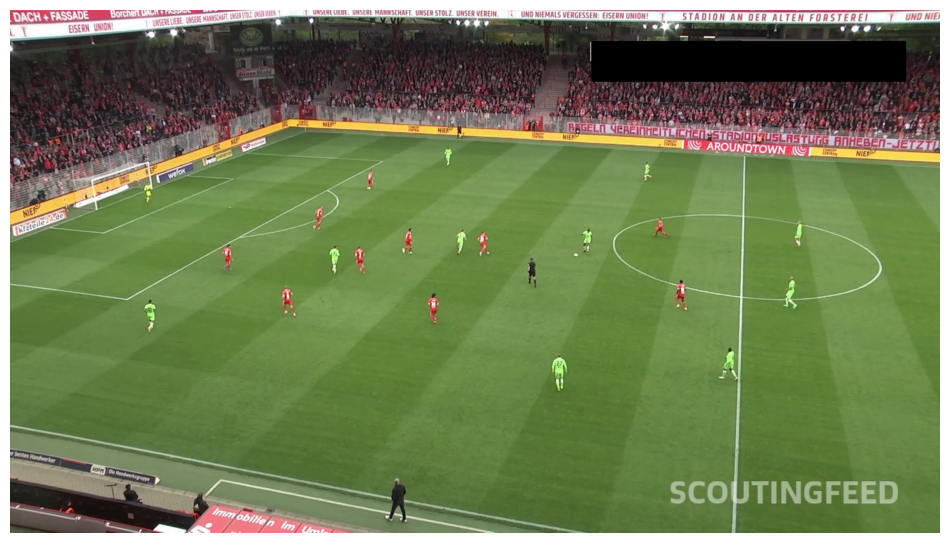

True

In [ ]:
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=300)
frame = next(frame_generator)

sv.plot_image(frame)

cv2.imwrite("121364_0-step-0-frame-300.png", frame)

To use the model with the frame, first we define box and label annotators to highlight the items detected

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

box_annotator = sv.BoxAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#FF8C00', '#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000')
)

Infer and show the annotated frame

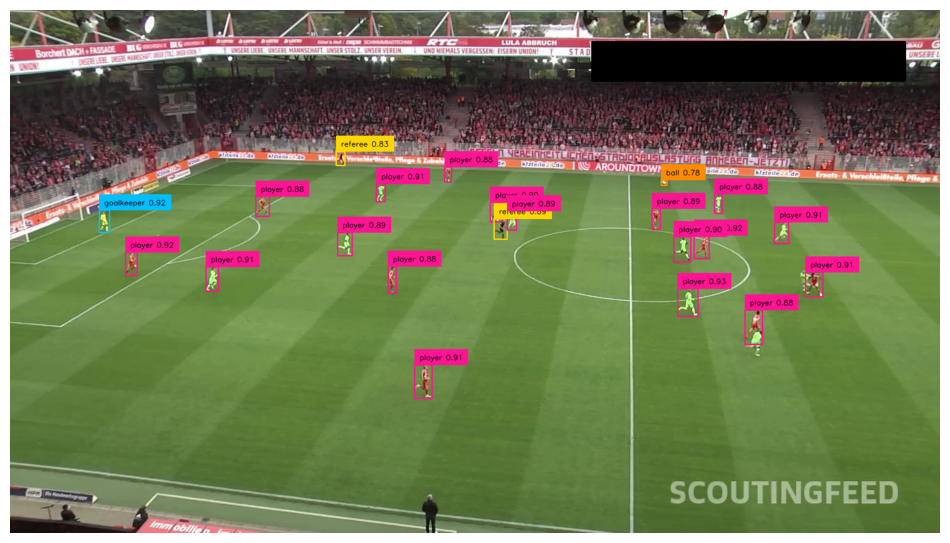

In [ ]:
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

labels = [
    f"{class_name} {confidence:.2f}"
    for class_name, confidence
    in zip(detections['class_name'], detections.confidence)
]

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections,
    labels=labels)

sv.plot_image(annotated_frame)

### Visualization

In this part we will improve the visualization of the results, we will draw ellipses instead of boxes for people and a triangle above the ball. To do this, we define an ellipse annotator and a triangle annotator.

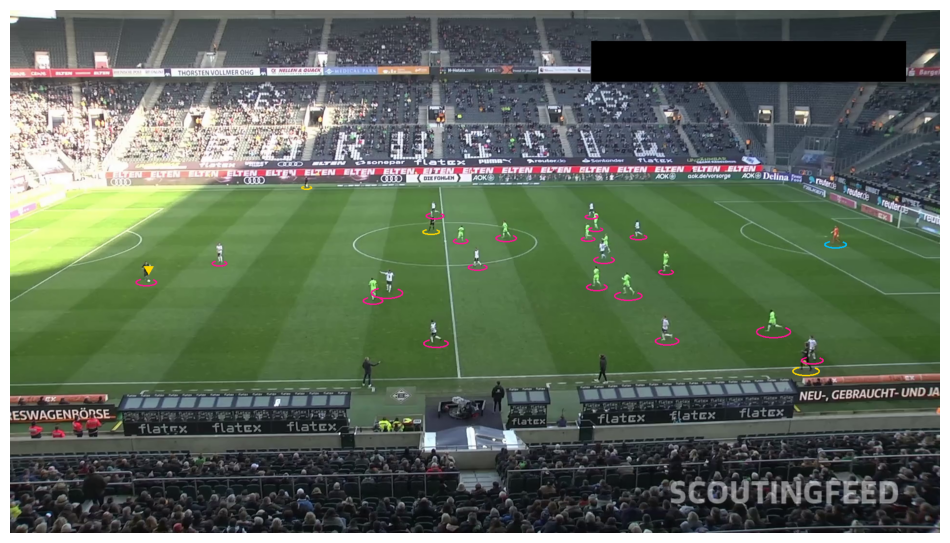

In [ ]:
SOURCE_VIDEO_PATH = "/content/08fd33_0.mp4"
BALL_ID = 0

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

# Move up the triangle
ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections.class_id -= 1

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

sv.plot_image(annotated_frame)

### Tracking

In this step, we will apply a tracker to the video, with the objective of getting measures for each player

First, we define the annotators

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

Then, we declare the tracker and apply it to all the detections but the ball

In [ ]:
tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections.class_id -= 1
all_detections = tracker.update_with_detections(detections=all_detections)

Annotate and show the result

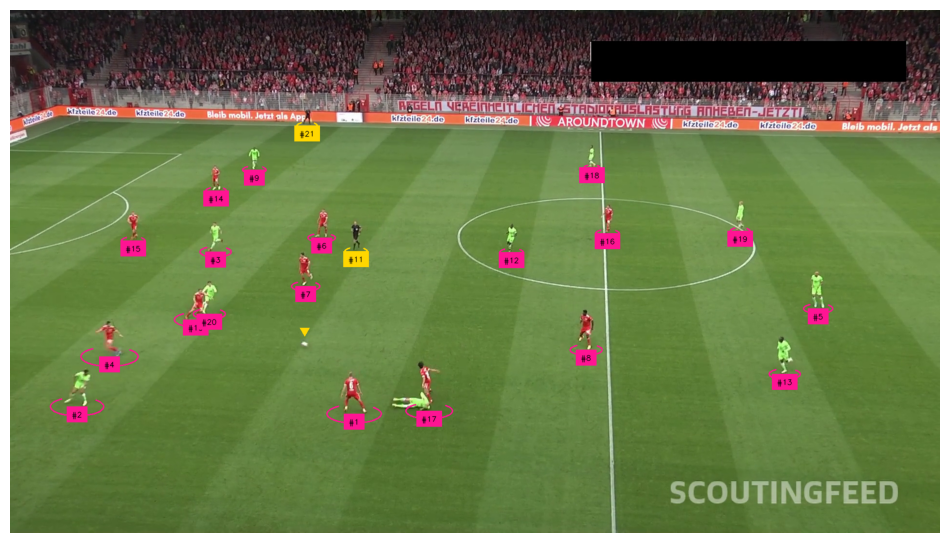

True

In [ ]:
labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

sv.plot_image(annotated_frame)

cv2.imwrite("121364_0-step-3.png", annotated_frame)

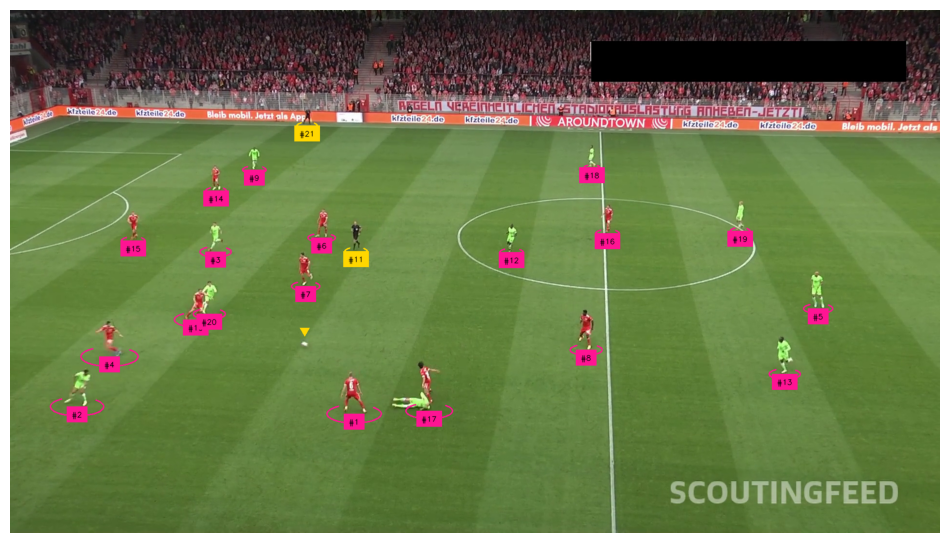

True

In [ ]:
tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections.class_id -= 1
all_detections = tracker.update_with_detections(detections=all_detections)

labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

sv.plot_image(annotated_frame)

cv2.imwrite("121364_0-step-3.png", annotated_frame)

Now we iterate through the frames to generate the output video

We can split this process into two steps so as to only apply the model once.

First we will infer the model and save the detections in each frame.

In [ ]:
tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

all_detections_list = []

ball_detections_list = []

for frame in tqdm(frame_generator, desc='infering model'):
    frame = frame.copy()
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)

    ball_detections = detections[detections.class_id == BALL_ID]
    ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)
    ball_detections_list.append(ball_detections)

    all_detections = detections[detections.class_id != BALL_ID]
    all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
    all_detections.class_id -= 1
    all_detections = tracker.update_with_detections(detections=all_detections)
    all_detections_list.append(all_detections)

print("")
print("Done!")

generating output video: 750it [03:36,  3.46it/s]


In [ ]:
def infer_model(SOURCE_VIDEO_PATH):
    tracker = sv.ByteTrack()
    tracker.reset()

    frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
    all_detections_list = []

    ball_detections_list = []

    for frame in tqdm(frame_generator, desc='infering model'):
        frame = frame.copy()
        result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
        detections = sv.Detections.from_inference(result)
        ball_detections = detections[detections.class_id == BALL_ID]
        ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)
        ball_detections_list.append(ball_detections)

        all_detections = detections[detections.class_id != BALL_ID]
        all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
        all_detections.class_id -= 1
        all_detections = tracker.update_with_detections(detections=all_detections)
        all_detections_list.append(all_detections)

    print("")
    print("Done!")
    return all_detections_list, ball_detections_list

Then we will annotate each frame.

In [ ]:
output_video_frames= []

index = 0

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

for frame in tqdm(frame_generator, desc='Annotating output frames'):

    all_detections = all_detections_list[index]
    ball_detections = ball_detections_list[index]

    labels = [
        f"#{tracker_id}"
        for tracker_id
        in all_detections.tracker_id
    ]


    annotated_frame = frame.copy()
    annotated_frame = ellipse_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections,
        labels=labels)
    annotated_frame = triangle_annotator.annotate(
        scene=annotated_frame,
        detections=ball_detections)

    output_video_frames.append(annotated_frame)
    index += 1

print("")
print("Done!")

Annotating output frames: 750it [00:23, 31.94it/s]

Done!


In [ ]:
def annotate_frame(frame, all_detections, ball_detections):
    labels = [
        f"#{tracker_id}"
        for tracker_id
        in all_detections.tracker_id
    ]

    annotated_frame = frame.copy()
    annotated_frame = ellipse_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections,
        labels=labels)
    annotated_frame = triangle_annotator.annotate(
        scene=annotated_frame,
        detections=ball_detections)

    return annotated_frame


In [ ]:
save_video(output_video_frames, 'output_video.avi')

In [ ]:
!ffmpeg -i output_video.avi output_video.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

Show the video in google colab

In [ ]:
# Cargar y codificar el video en formato .mp4
video_path = 'output_video.mp4'
video = open(video_path, 'rb').read()
video_encoded = b64encode(video).decode('ascii')

# Mostrar el video
HTML(data=f'''
    <video width="640" height="480" controls>
        <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
        Tu navegador no soporta la etiqueta de video.
    </video>
''')

We see that the ball is often not detected. Let's improve it in the following section.

### Improve ball tracking

We will interpolate the ball position when it is not detected in the frame

In [ ]:
all_detections_list, ball_detections_list = infer_model(SOURCE_VIDEO_PATH)

infering model: 750it [03:55,  3.18it/s]


Done!


Store ball positions

In [ ]:
ball_positions = []

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

index = 0
for frame in tqdm(frame_generator, desc='storing ball position'):
    frame = frame.copy()

    ball_detections = ball_detections_list[index]

    if len(ball_detections) > 0:
        ball_positions.append({1: {"bbox": ball_detections.xyxy[0].tolist()}})
    else:
        ball_positions.append({1: {"bbox": []}})  # Si no hay detección, almacenar una lista vacía

    index += 1

interpolating ball position: 750it [00:12, 60.43it/s]


In [ ]:
def interpolate_ball_positions(ball_positions):
    ball_positions = [x.get(1, {}).get('bbox', []) for x in ball_positions]
    df_ball_positions = pd.DataFrame(ball_positions, columns=['x1', 'y1', 'x2', 'y2'])

    # Interpolar valores faltantes
    df_ball_positions = df_ball_positions.interpolate()
    df_ball_positions = df_ball_positions.bfill()

    ball_positions = [{1: {"bbox": x}} for x in df_ball_positions.to_numpy().tolist()]

    return ball_positions

In [ ]:
# Interpolación de las posiciones de la pelota
interpolated_ball_positions = interpolate_ball_positions(ball_positions)

In [ ]:
output_video_frames = []

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

index = 0

for frame in tqdm(frame_generator, desc='Annotating output frames'):
    frame = frame.copy()

    all_detections = all_detections_list[index]
    ball_detections = ball_detections_list[index]
    ball_position = interpolated_ball_positions[index].get(1, {}).get('bbox', [])


    if ball_position:
        ball_position = np.array(ball_position).reshape(1, 4)

        if len(ball_detections) > 0:
            ball_detections.xyxy[0] = ball_position[0]
        else:
            ball_detections = sv.Detections(
                xyxy=ball_position,
                confidence=np.array([1.0]),
                class_id=np.array([BALL_ID])
            )
    else:
        ball_detections.xyxy = np.empty((0, 4))

    annotated_frame = annotate_frame(frame, all_detections, ball_detections)

    output_video_frames.append(annotated_frame)
    index += 1

print("")
print("Done!")

Annotating output frames: 750it [00:17, 42.07it/s]


Done!


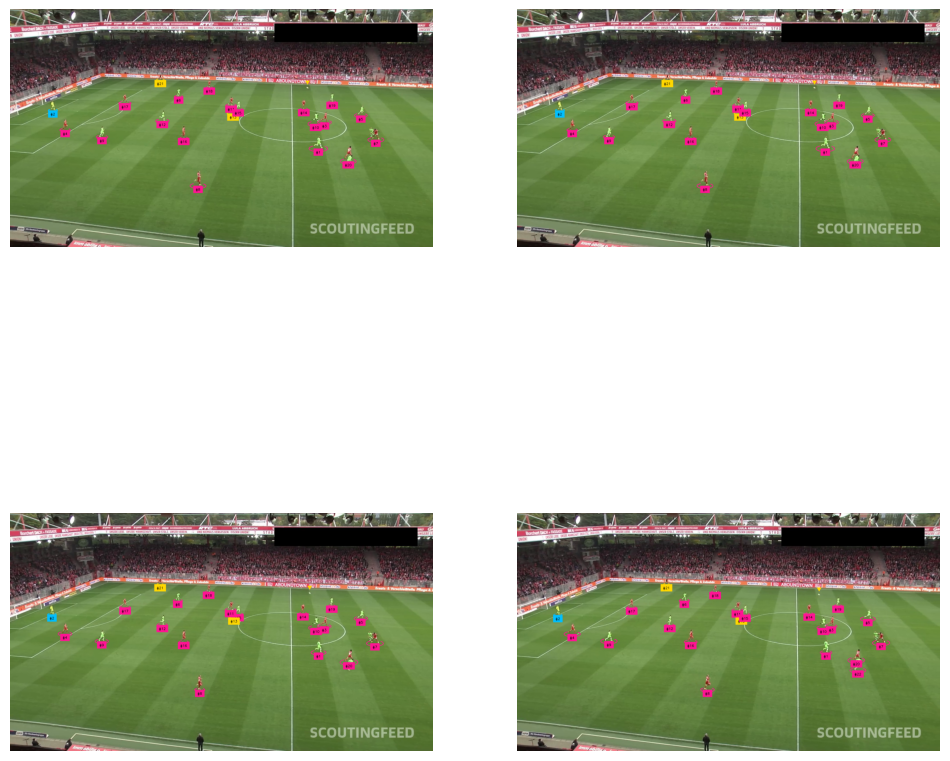

In [ ]:
sv.plot_images_grid(output_video_frames[:4], grid_size=(2, 2))

In [ ]:
save_video(output_video_frames, 'output_video_2.avi')

In [ ]:
!ffmpeg -i output_video_2.avi output_video_2.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Cargar y codificar el video en formato .mp4
video_path = 'output_video_2.mp4'
video = open(video_path, 'rb').read()
video_encoded = b64encode(video).decode('ascii')

# Mostrar el video
HTML(data=f'''
    <video width="640" height="480" controls>
        <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
        Tu navegador no soporta la etiqueta de video.
    </video>
''')

As a result, the ball detection is smoother.

## Detect Teams

### Solution 1

To detect the two teams of a football match, we will crop the detections boxes of all the players in every frame and then we will apply a SigLip model followed by a dimension reducer and KMeans

In [ ]:
PLAYER_ID = 2
STRIDE = 30

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []
for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)
    detections = detections[detections.class_id == PLAYER_ID]
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
    crops += players_crops

collecting crops: 25it [00:14,  1.71it/s]


Plot 100 crops

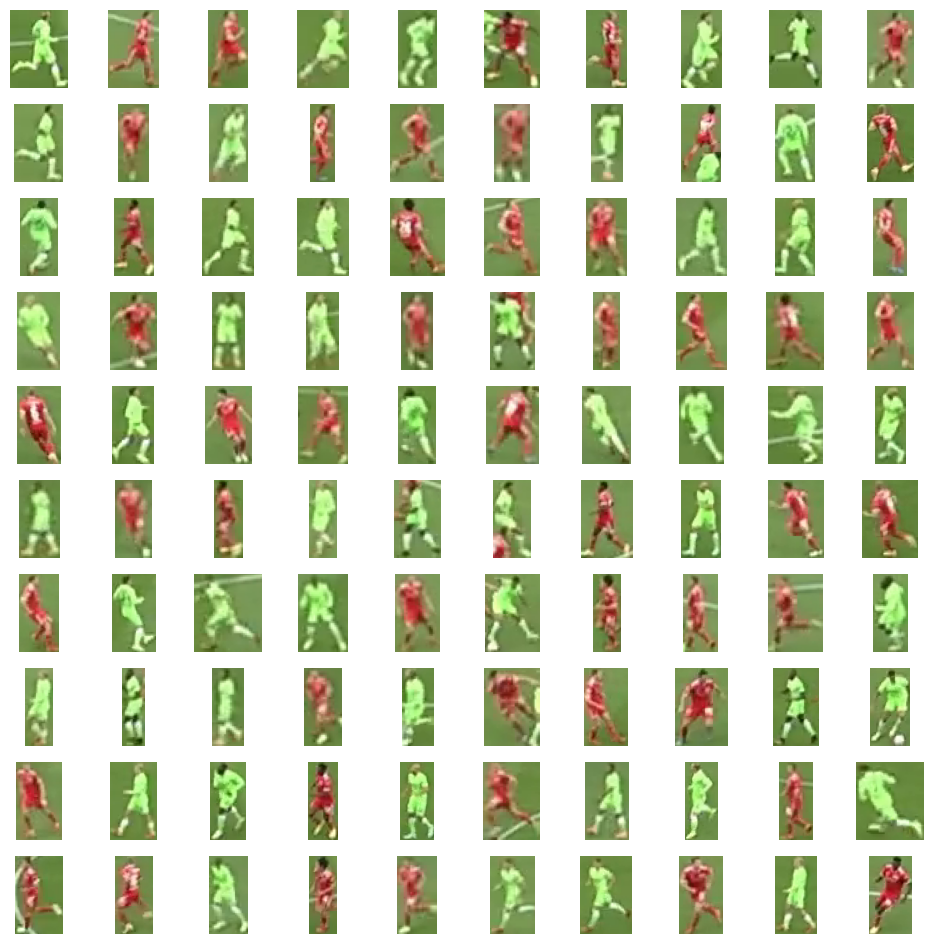

In [ ]:
sv.plot_images_grid(crops[:100], grid_size=(10, 10))

In [ ]:
SIGLIP_MODEL_PATH = 'google/siglip-base-patch16-224'

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
EMBEDDINGS_MODEL = SiglipVisionModel.from_pretrained(SIGLIP_MODEL_PATH).to(DEVICE)
EMBEDDINGS_PROCESSOR = AutoProcessor.from_pretrained(SIGLIP_MODEL_PATH)

The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/813M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/368 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/711 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/798k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/409 [00:00<?, ?B/s]

In [ ]:
BATCH_SIZE = 32

crops = [sv.cv2_to_pillow(crop) for crop in crops]
batches = chunked(crops, BATCH_SIZE)
data = []
with torch.no_grad():
    for batch in tqdm(batches, desc='embedding extraction'):
        inputs = EMBEDDINGS_PROCESSOR(images=batch, return_tensors="pt").to(DEVICE)
        outputs = EMBEDDINGS_MODEL(**inputs)
        embeddings = torch.mean(outputs.last_hidden_state, dim=1).cpu().numpy()
        data.append(embeddings)

data = np.concatenate(data)

embedding extraction: 15it [00:06,  2.18it/s]


Reduce and cluster the data

In [ ]:
REDUCER = umap.UMAP(n_components=3)
CLUSTERING_MODEL = KMeans(n_clusters=2)

In [ ]:
projections = REDUCER.fit_transform(data)
clusters = CLUSTERING_MODEL.fit_predict(projections)

Show examples of players of one team

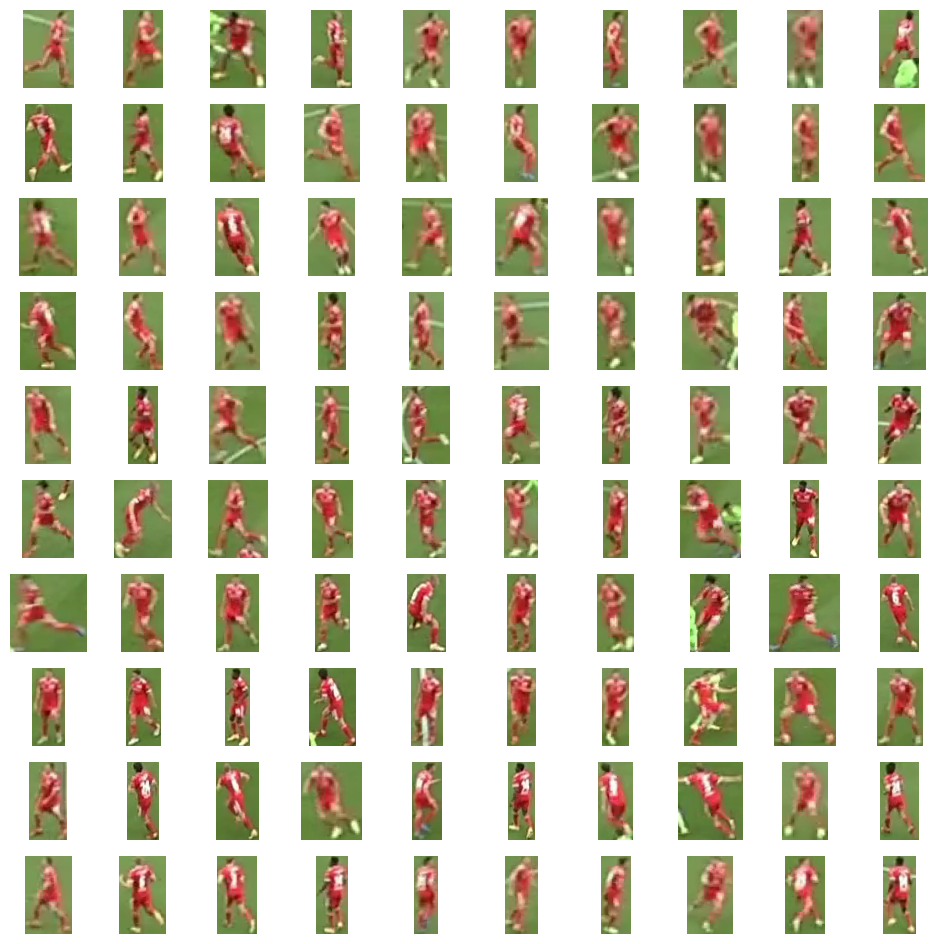

In [ ]:
team_0 = [
    crop
    for crop, cluster
    in zip(crops, clusters)
    if cluster == 0
]

sv.plot_images_grid(team_0[:100], grid_size=(10, 10))

Assign goalkeepers to the team with the closest centroid

In [ ]:
def resolve_goalkeepers_team_id(
    players: sv.Detections,
    goalkeepers: sv.Detections
) -> np.ndarray:
    goalkeepers_xy = goalkeepers.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    players_xy = players.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    team_0_centroid = players_xy[players.class_id == 0].mean(axis=0)
    team_1_centroid = players_xy[players.class_id == 1].mean(axis=0)
    goalkeepers_team_id = []
    for goalkeeper_xy in goalkeepers_xy:
        dist_0 = np.linalg.norm(goalkeeper_xy - team_0_centroid)
        dist_1 = np.linalg.norm(goalkeeper_xy - team_1_centroid)
        goalkeepers_team_id.append(0 if dist_0 < dist_1 else 1)

    return np.array(goalkeepers_team_id)

In [ ]:
import supervision as sv
from tqdm import tqdm
from typing import List
from sports.common.team import TeamClassifier

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2
STRIDE = 30

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []
for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    players_detections = detections[detections.class_id == PLAYER_ID]
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
    crops += players_crops

team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)

collecting crops: 25it [00:13,  1.85it/s]
Embedding extraction: 18it [00:07,  2.56it/s]


Embedding extraction: 1it [00:00,  4.44it/s]


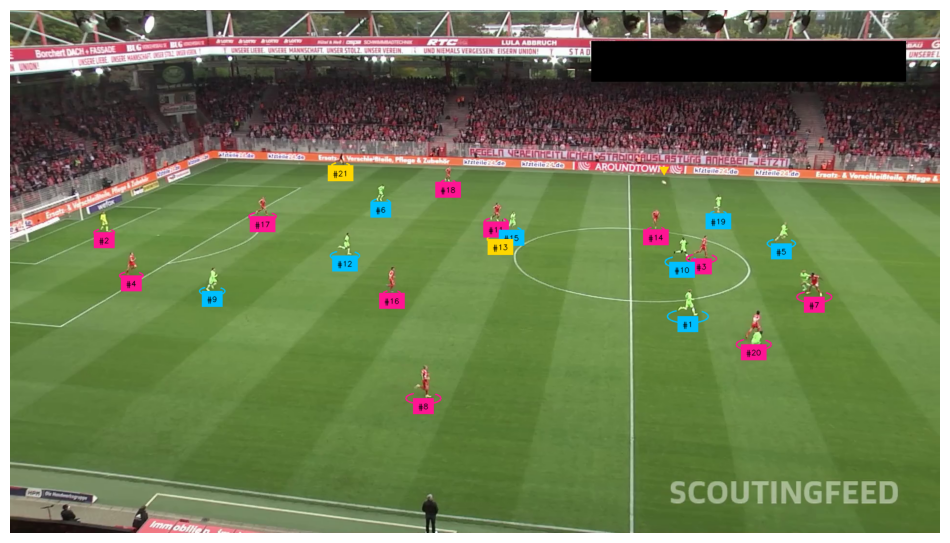

In [ ]:
import supervision as sv

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_detections.class_id = team_classifier.predict(players_crops)

goalkeepers_detections.class_id = resolve_goalkeepers_team_id(
    players_detections, goalkeepers_detections)

referees_detections.class_id -= 1

all_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections, referees_detections])

labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

all_detections.class_id = all_detections.class_id.astype(int)

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

sv.plot_image(annotated_frame)

### Solution 2 (Faster but less accurate)

A faster and more simple solution is to detect the color of the teams' shirts with KMeans

In [ ]:
PLAYER_ID = 2
STRIDE = 30

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

crops = []
for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)
    detections = detections[detections.class_id == PLAYER_ID]

    for xyxy in detections.xyxy:
        crop = sv.crop_image(frame, xyxy)
        # Get the top half of the crop
        height = crop.shape[0]
        top_half_crop = crop[:height//2, :]
        crops.append(top_half_crop)


collecting crops: 25it [00:12,  1.98it/s]


Plot 100 top half crops

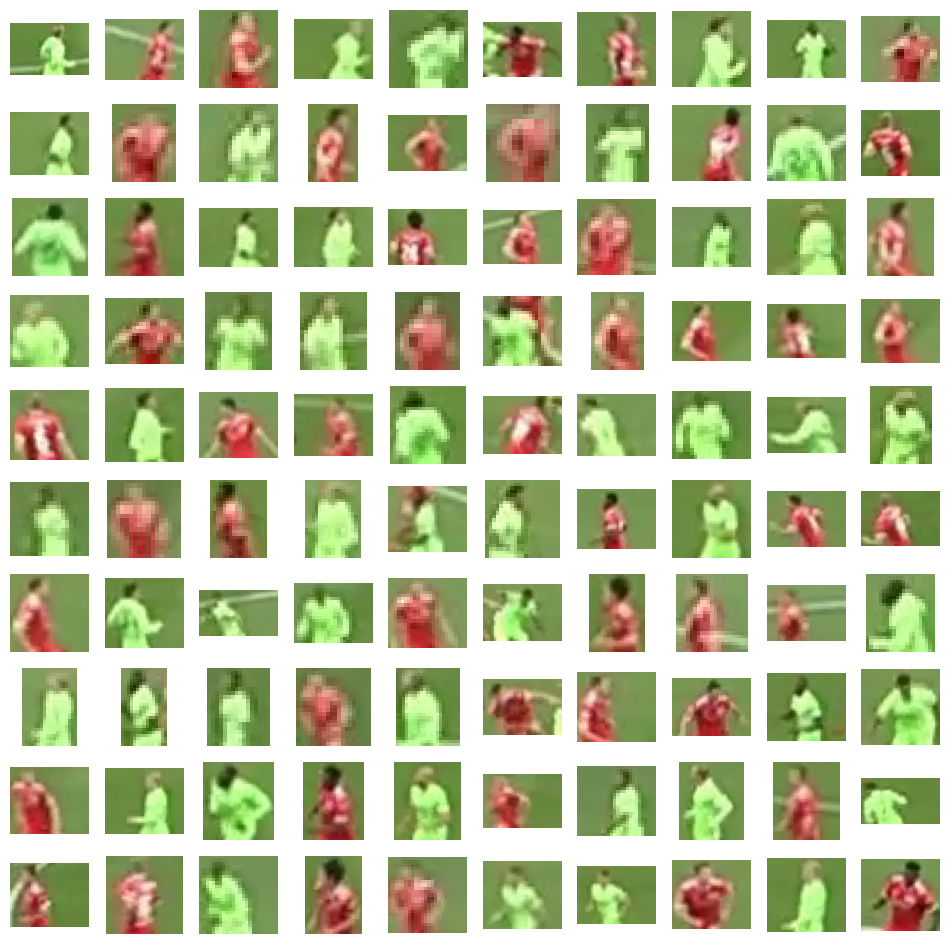

In [ ]:
sv.plot_images_grid(crops[:100], grid_size=(10, 10))

In [ ]:
PLAYER_ID = 2
STRIDE = 30

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

clustered_images = []
for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)
    detections = detections[detections.class_id == PLAYER_ID]

    for xyxy in detections.xyxy:
        crop = sv.crop_image(frame, xyxy)
        # Get the top half of the crop
        height = crop.shape[0]
        top_half_crop = crop[:height//2, :]

        kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(top_half_crop.reshape(-1, 3))

        labels = kmeans.labels_

        clustered_image = labels.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

        corner_clusters = [clustered_image[0, 0], clustered_image[0, -1], clustered_image[-1, 0], clustered_image[-1, -1]]
        non_player_cluster = max(set(corner_clusters),key=corner_clusters.count)
        player_cluster = 1 - non_player_cluster

        player_color = kmeans.cluster_centers_[player_cluster]
        clustered_images.append(clustered_image)

collecting crops: 25it [00:17,  1.45it/s]


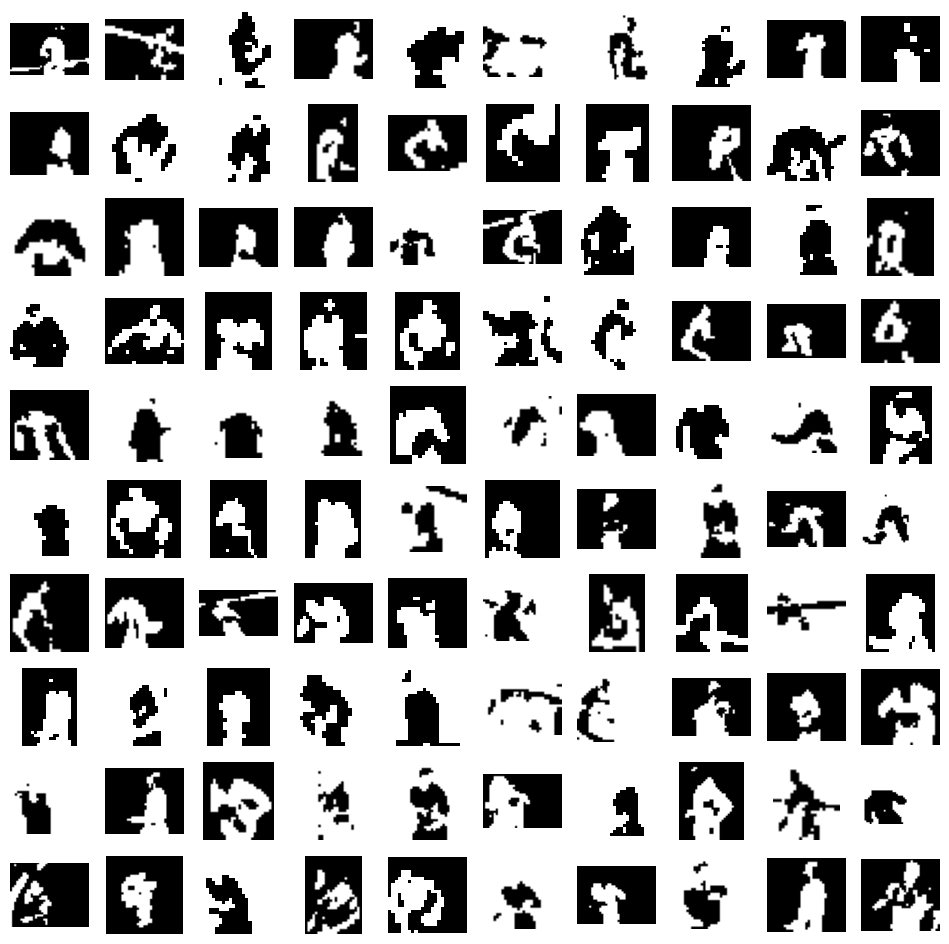

In [ ]:
sv.plot_images_grid(clustered_images[:100], grid_size=(10, 10))

In [ ]:
PLAYER_ID = 2
STRIDE = 30

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

player_colors = []
for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)
    detections = detections[detections.class_id == PLAYER_ID]

    for xyxy in detections.xyxy:
        crop = sv.crop_image(frame, xyxy)
        # Get the top half of the crop
        height = crop.shape[0]
        top_half_crop = crop[:height//2, :]

        kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(top_half_crop.reshape(-1, 3))

        labels = kmeans.labels_

        clustered_image = labels.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

        corner_clusters = [clustered_image[0, 0], clustered_image[0, -1], clustered_image[-1, 0], clustered_image[-1, -1]]
        non_player_cluster = max(set(corner_clusters),key=corner_clusters.count)
        player_cluster = 1 - non_player_cluster

        player_color = kmeans.cluster_centers_[player_cluster]

        player_colors.append(player_color)


collecting crops: 25it [00:17,  1.45it/s]


In [ ]:
kmeans_2 = KMeans(n_clusters=2, random_state=0, n_init=10).fit(np.array(player_colors))

team_color_1 = kmeans_2.cluster_centers_[0]
team_color_2 = kmeans_2.cluster_centers_[1]

In [ ]:
team_color_1, team_color_2

(array([131.81766292, 151.05209612, 206.56639283]),
 array([143.92862397, 235.79259925, 187.74080089]))

In [ ]:
team_ids = []

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    detections = detections.with_nms(threshold=0.5, class_agnostic=True)
    detections = detections[detections.class_id == PLAYER_ID]

    for xyxy in detections.xyxy:
        crop = sv.crop_image(frame, xyxy)
        # Get the top half of the crop
        height = crop.shape[0]
        top_half_crop = crop[:height//2, :]

        kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(top_half_crop.reshape(-1, 3))

        labels = kmeans.labels_

        clustered_image = labels.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

        corner_clusters = [clustered_image[0, 0], clustered_image[0, -1], clustered_image[-1, 0], clustered_image[-1, -1]]
        non_player_cluster = max(set(corner_clusters),key=corner_clusters.count)
        player_cluster = 1 - non_player_cluster

        player_color = kmeans.cluster_centers_[player_cluster]

        team_id = kmeans_2.predict(player_color.reshape(1, -1))[0]
        team_id += 1

        team_ids.append(team_id)

print(team_ids)

collecting crops: 25it [00:17,  1.43it/s]

[2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 1, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 1, 1, 2, 2, 1, 2, 1, 1, 2, 2, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 1, 1, 1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 1, 1, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 2, 1, 1, 2, 1, 2, 2, 2, 2, 1, 

In [ ]:
def resolve_goalkeepers_team_id(
    players: sv.Detections,
    goalkeepers: sv.Detections
) -> np.ndarray:
    goalkeepers_xy = goalkeepers.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    players_xy = players.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    team_0_centroid = players_xy[players.class_id == 0].mean(axis=0)
    team_1_centroid = players_xy[players.class_id == 1].mean(axis=0)
    goalkeepers_team_id = []
    for goalkeeper_xy in goalkeepers_xy:
        dist_0 = np.linalg.norm(goalkeeper_xy - team_0_centroid)
        dist_1 = np.linalg.norm(goalkeeper_xy - team_1_centroid)
        goalkeepers_team_id.append(0 if dist_0 < dist_1 else 1)

    return np.array(goalkeepers_team_id)

Initial detections: Detections(xyxy=array([[1378.,  576., 1420.,  633.],
       [ 184.,  414.,  205.,  460.],
       [1412.,  466., 1443.,  514.],
       [ 238.,  501.,  262.,  549.],
       [1578.,  439., 1607.,  483.],
       [ 756.,  360.,  774.,  397.],
       [1642.,  542., 1678.,  593.],
       [ 835.,  733.,  871.,  802.],
       [ 404.,  531.,  430.,  581.],
       [1370.,  469., 1405.,  521.],
       [ 991.,  398., 1015.,  438.],
       [ 676.,  460.,  706.,  508.],
       [ 999.,  432., 1026.,  474.],
       [1325.,  411., 1342.,  454.],
       [1026.,  416., 1045.,  455.],
       [ 780.,  530.,  797.,  585.],
       [ 507.,  386.,  535.,  427.],
       [ 897.,  325.,  911.,  356.],
       [1454.,  381., 1470.,  421.],
       [1517.,  620., 1553.,  691.],
       [ 673.,  293.,  691.,  322.],
       [1344.,  352., 1356.,  363.]]), mask=None, confidence=array([0.92665607, 0.92325735, 0.9197337 , 0.91591448, 0.91462475,
       0.91420698, 0.91155273, 0.91140985, 0.90719187, 0.90

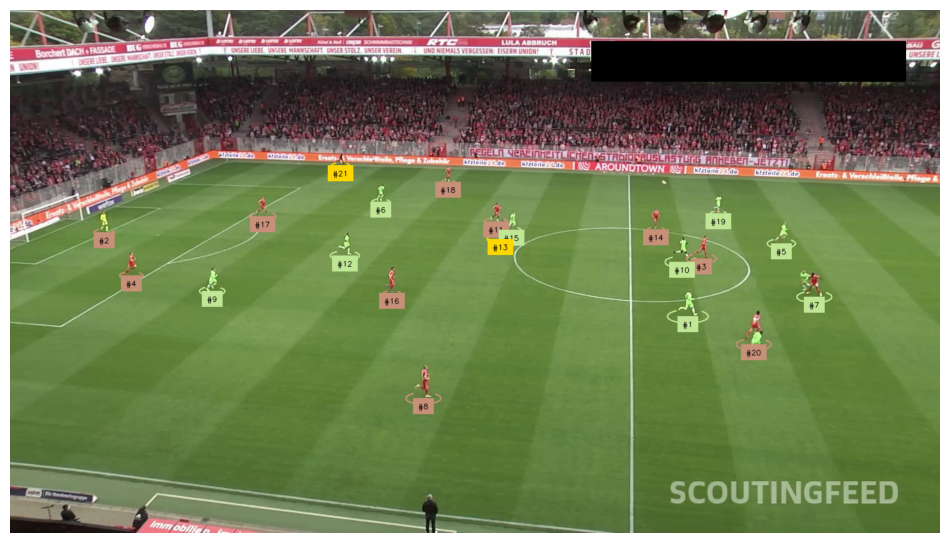

In [ ]:
# Step 3: Initialize video source and detection parameters
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

tracker = sv.ByteTrack()
tracker.reset()

# Step 4: Extract the first frame and perform initial detections
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

print("Initial detections:", detections)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

print("Goalkeepers detections:", goalkeepers_detections)
print("Players detections:", players_detections)
print("Referees detections:", referees_detections)

# Step 5: Extract top half of player crops for color analysis
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_top_half_crops = [crop[:crop.shape[0]//2, :] for crop in players_crops]

print("Number of player crops:", len(players_crops))
print("Top half of player crops extracted successfully.")

# Step 6: Use KMeans to cluster player colors and determine team colors
player_colors = []
for i, top_half_crop in enumerate(players_top_half_crops):
    print(f"Processing player {i + 1}/{len(players_top_half_crops)}")
    kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(top_half_crop.reshape(-1, 3))
    labels = kmeans.labels_.reshape(top_half_crop.shape[:2])

    corner_clusters = [
        labels[0, 0], labels[0, -1], labels[-1, 0], labels[-1, -1]
    ]
    non_player_cluster = max(set(corner_clusters), key=corner_clusters.count)
    player_cluster = 1 - non_player_cluster

    player_color = kmeans.cluster_centers_[player_cluster]
    player_colors.append(player_color)

    print(f"Player {i + 1} color (RGB): {player_color}")

# Step 7: Classify players into two teams using KMeans
print("Player colors:", player_colors)
kmeans_2 = KMeans(n_clusters=2, random_state=0, n_init=10).fit(player_colors)
team_ids = [kmeans_2.predict(color.reshape(1, -1))[0] for color in player_colors]
players_detections.class_id = np.array(team_ids)

print("Team IDs assigned to players:", team_ids)

# Assign team IDs to goalkeepers
goalkeepers_detections.class_id = resolve_goalkeepers_team_id(players_detections, goalkeepers_detections)
referees_detections.class_id -= 1  # Decrement referees class_id for annotation purposes

# Step 8: Merge all detections
all_detections = sv.Detections.merge([players_detections, goalkeepers_detections, referees_detections])

# Step 9: Extract team colors and prepare for annotation
team_colors_bgr = kmeans_2.cluster_centers_.astype(int)

def rgb2hex(r,g,b):
    return "#{:02x}{:02x}{:02x}".format(r,g,b)

def hex2rgb(hexcode):
    return tuple(map(ord,hexcode[1:].decode('hex')))

# Convert RGB to HEX
team_colors_hex = [rgb2hex(color[2], color[1], color[0]) for color in team_colors_bgr]

print("Team colors (HEX):", team_colors_hex)


ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)

labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

# Step 11: Annotate the frame and display
print("Annotating frame...")
annotated_frame = ellipse_annotator.annotate(scene=frame, detections=all_detections)
annotated_frame = label_annotator.annotate(scene=annotated_frame, detections=all_detections, labels=labels)

print("Displaying annotated frame...")
sv.plot_image(annotated_frame)


## Generating video

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

batch_size = 1

tracker = sv.ByteTrack()
tracker.reset()

In [ ]:
all_detections_list, ball_detections_list = infer_model(SOURCE_VIDEO_PATH)

infering model: 750it [04:04,  3.06it/s]


Done!


In [ ]:
ball_positions = []

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

index = 0
for frame in tqdm(frame_generator, desc='storing ball position'):
    frame = frame.copy()

    ball_detections = ball_detections_list[index]

    if len(ball_detections) > 0:
        ball_positions.append({1: {"bbox": ball_detections.xyxy[0].tolist()}})
    else:
        ball_positions.append({1: {"bbox": []}})  # Si no hay detección, almacenar una lista vacía

    index += 1

storing ball position: 750it [00:14, 51.16it/s]


In [ ]:
# Interpolación de las posiciones de la pelota
interpolated_ball_positions = interpolate_ball_positions(ball_positions)

Detect Teams in one frame

In [ ]:
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex(['#00BFFF', '#FF1493', '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)


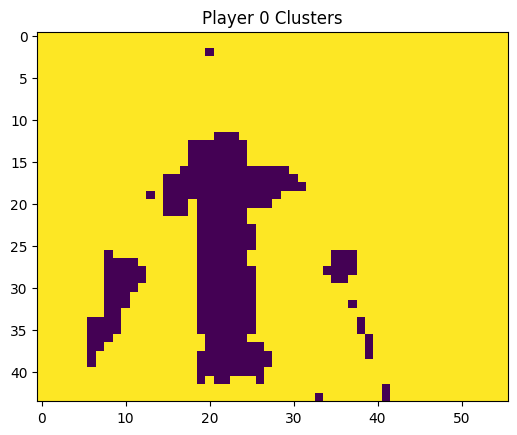

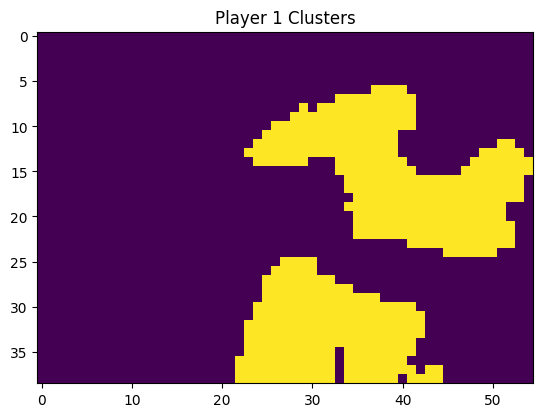

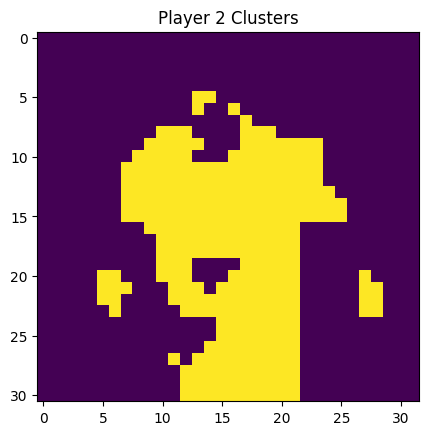

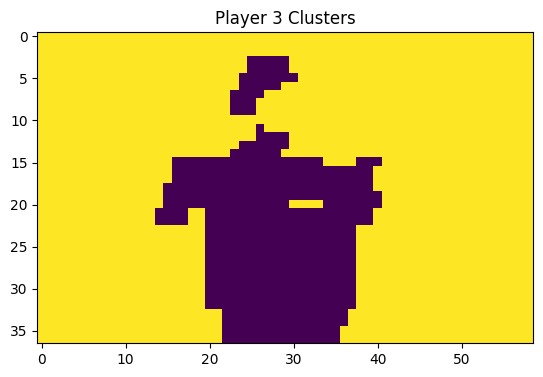

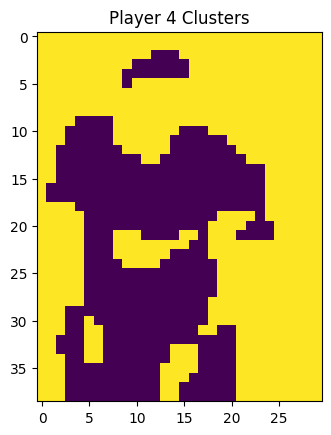

...

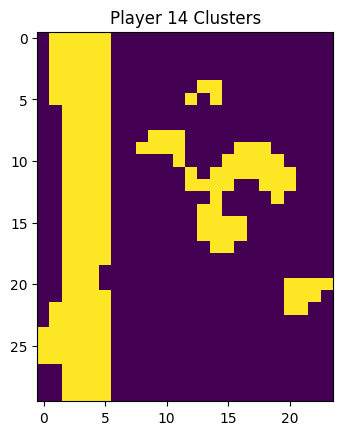

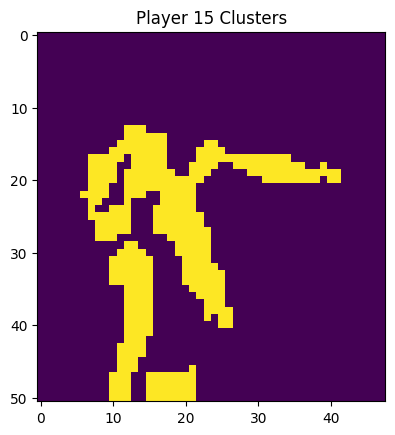

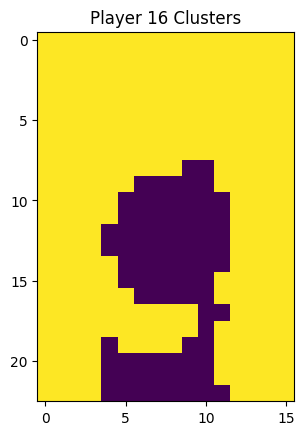

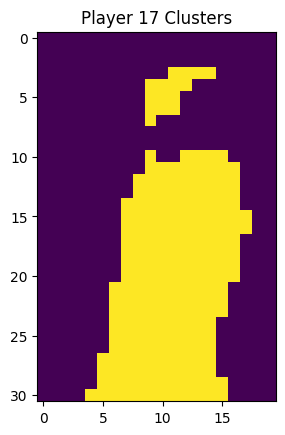

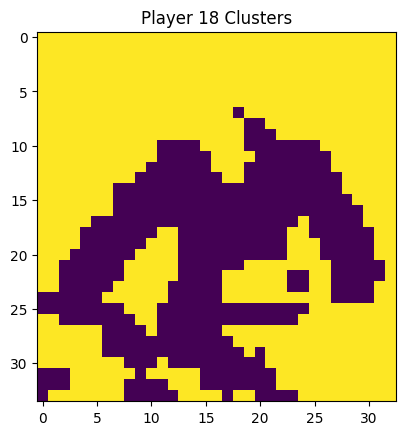

Player 0: Color (BGR) = [163.80456026 176.76872964 226.33876221], Team ID = 0
Player 1: Color (BGR) = [129.85882353 230.83921569 176.85686275], Team ID = 0
Player 2: Color (BGR) = [131.70588235 233.67820069 182.14186851], Team ID = 0
Player 3: Color (BGR) = [ 56.48535565  71.05857741 162.27196653], Team ID = 1
Player 4: Color (BGR) = [122.02       233.70444444 172.01777778], Team ID = 0
Player 5: Color (BGR) = [ 97.71176471 109.26764706 195.49705882], Team ID = 1
Player 6: Color (BGR) = [ 44.76490066  49.11589404 158.34768212], Team ID = 1
Player 7: Color (BGR) = [ 38.84972171  49.67532468 133.45640074], Team ID = 1
Player 8: Color (BGR) = [128.80097087 234.54368932 170.09223301], Team ID = 0
Player 9: Color (BGR) = [ 56.45723684  65.56578947 169.80592105], Team ID = 1
Player 10: Color (BGR) = [139.00934579 236.65420561 182.42056075], Team ID = 0
Player 11: Color (BGR) = [131.07736944 239.9516441  172.23791103], Team ID = 0
Player 12: Color (BGR) = [ 99.03809524 116.49047619 197.376190

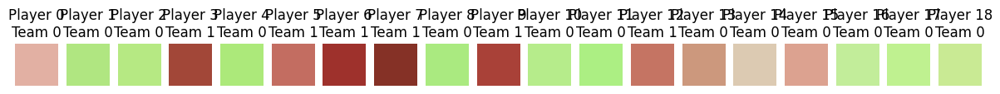

Team colors (HEX): ['#c1d88d', '#a94c41']


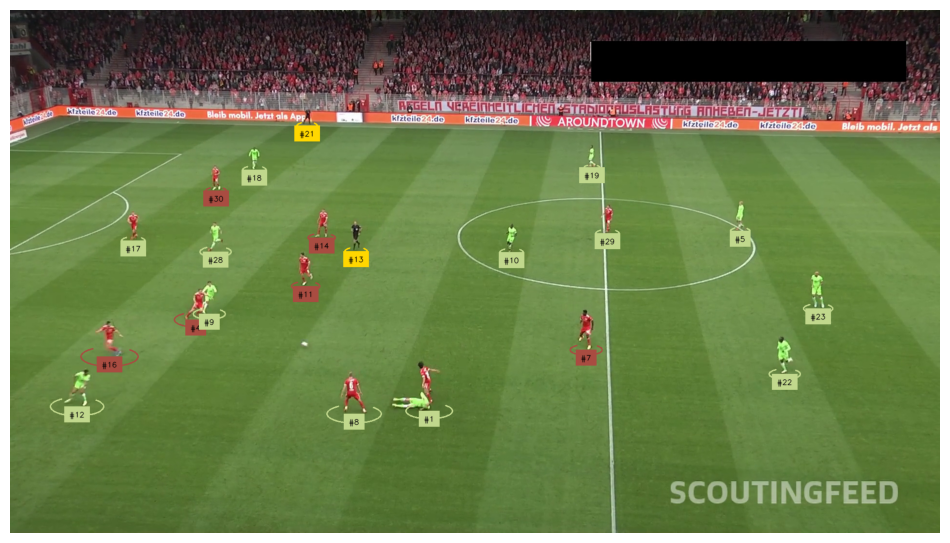

In [ ]:
import supervision as sv
import cv2
import numpy as np
from sklearn.cluster import KMeans
from sports.annotators.soccer import (
    draw_pitch,
    draw_points_on_pitch,
    draw_pitch_voronoi_diagram
)

# Step 3: Initialize video source and detection parameters
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
#BALL_ID = 0
GOALKEEPER_ID = 0
PLAYER_ID = 1
REFEREE_ID = 2

tracker = sv.ByteTrack()
tracker.reset()

# Step 4: Extract the first frame and perform initial detections
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

ball_detections = ball_detections_list[200]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = all_detections_list[200]

goalkeepers_detections = all_detections_list[200][all_detections_list[200].class_id == GOALKEEPER_ID]
players_detections = all_detections_list[200][all_detections_list[200].class_id == PLAYER_ID]
referees_detections = all_detections_list[200][all_detections_list[200].class_id == REFEREE_ID]

# Step 5: Extract top half of player crops for color analysis
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_top_half_crops = [crop[:crop.shape[0]//2, :] for crop in players_crops]

import matplotlib.pyplot as plt

# Step 6: Use KMeans to cluster player colors and determine team colors
player_colors = []
for i, top_half_crop in enumerate(players_top_half_crops):
    kmeans = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=1).fit(top_half_crop.reshape(-1, 3))

    labels = kmeans.labels_.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

    corner_clusters = [
        labels[0, 0], labels[0, -1], labels[-1, 0], labels[-1, -1]
    ]
    non_player_cluster = max(set(corner_clusters), key=corner_clusters.count)
    player_cluster = 1 - non_player_cluster

    player_color = kmeans.cluster_centers_[player_cluster]
    player_colors.append(player_color)

    # Visualize the clusters
    plt.figure()
    plt.imshow(labels, cmap='viridis')
    plt.title(f'Player {i} Clusters')
    plt.show()

# Step 7: Classify players into two teams using KMeans
kmeans_2 = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=10).fit(player_colors)
team_ids = [int(kmeans_2.predict(color.reshape(1, -1))[0]) for color in player_colors]

# Print each player's color and its prediction
for i, (color, team_id) in enumerate(zip(player_colors, team_ids)):
    print(f"Player {i}: Color (BGR) = {color}, Team ID = {team_id}")

# Plot the colors
fig, ax = plt.subplots(1, len(player_colors), figsize=(15, 2))
for i, color in enumerate(player_colors):
    color_rgb = color[::-1] / 255.0  # Convert BGR to RGB and normalize to [0, 1]
    ax[i].imshow([[color_rgb]])
    ax[i].set_title(f"Player {i}\nTeam {team_ids[i]}")
    ax[i].axis('off')

plt.show()

players_detections.class_id = np.array(team_ids).astype(int)


# Assign team IDs to goalkeepers
goalkeepers_detections.class_id = resolve_goalkeepers_team_id(players_detections, goalkeepers_detections)
referees_detections.class_id = referees_detections.class_id.astype(int)  # Convertir a int

# Step 8: Merge all detections
all_detections = sv.Detections.merge([players_detections, goalkeepers_detections, referees_detections])

# Convertir `all_detections.class_id` a int por si aún no lo es
all_detections.class_id = all_detections.class_id.astype(int)

# Step 9: Extract team colors and prepare for annotation
team_colors_bgr = kmeans_2.cluster_centers_.astype(int)

def rgb2hex(r, g, b):
    return "#{:02x}{:02x}{:02x}".format(r, g, b)

# Convert RGB to HEX
team_colors_hex = [rgb2hex(color[2], color[1], color[0]) for color in team_colors_bgr]

print("Team colors (HEX):", team_colors_hex)

ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)

labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

# Step 11: Annotate the frame and display
annotated_frame = ellipse_annotator.annotate(scene=frame, detections=all_detections)
annotated_frame = label_annotator.annotate(scene=annotated_frame, detections=all_detections, labels=labels)

sv.plot_image(annotated_frame)


In [ ]:
import matplotlib.pyplot as plt

def team_color_detection(players_detections, player_crops):
    # Step 5: Extract top half of player crops for color analysis
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
    players_top_half_crops = [crop[:crop.shape[0]//2, :] for crop in players_crops]

    # Step 6: Use KMeans to cluster player colors and determine team colors
    player_colors = []
    for i, top_half_crop in enumerate(players_top_half_crops):
        kmeans = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=1).fit(top_half_crop.reshape(-1, 3))

        labels = kmeans.labels_.reshape(top_half_crop.shape[0], top_half_crop.shape[1])

        corner_clusters = [
            labels[0, 0], labels[0, -1], labels[-1, 0], labels[-1, -1]
        ]
        non_player_cluster = max(set(corner_clusters), key=corner_clusters.count)
        player_cluster = 1 - non_player_cluster

        player_color = kmeans.cluster_centers_[player_cluster]
        player_colors.append(player_color)

    # Step 7: Classify players into two teams using KMeans
    kmeans_2 = KMeans(n_clusters=2, random_state=0, init='k-means++', n_init=10).fit(player_colors)
    team_ids = [int(kmeans_2.predict(color.reshape(1, -1))[0]) for color in player_colors]


    # Step 9: Extract team colors and prepare for annotation
    team_colors_bgr = kmeans_2.cluster_centers_.astype(int)

    def rgb2hex(r, g, b):
        return "#{:02x}{:02x}{:02x}".format(r, g, b)

    # Convert RGB to HEX
    team_colors_hex = [rgb2hex(color[2], color[1], color[0]) for color in team_colors_bgr]

    return team_colors_hex

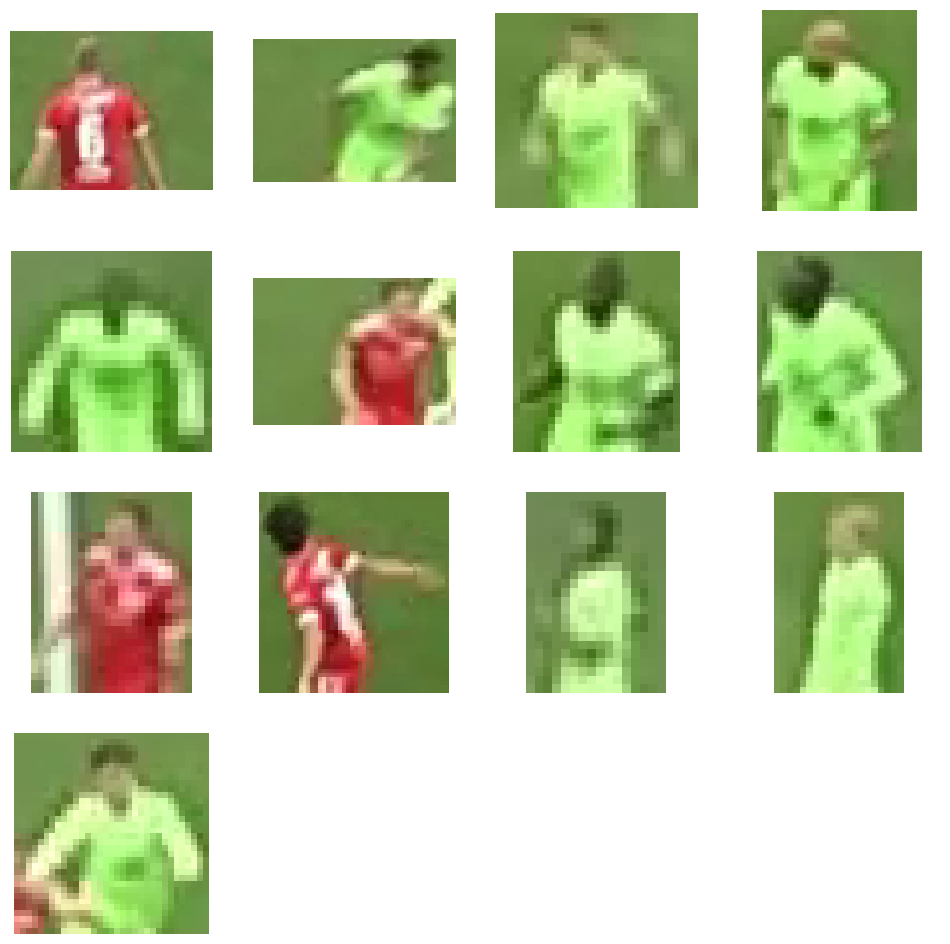

In [ ]:
team_0 = [
    crop
    for crop, cluster
    in zip(players_top_half_crops, team_ids)
    if cluster == 0
]

sv.plot_images_grid(team_0[:16], grid_size=(4, 4))

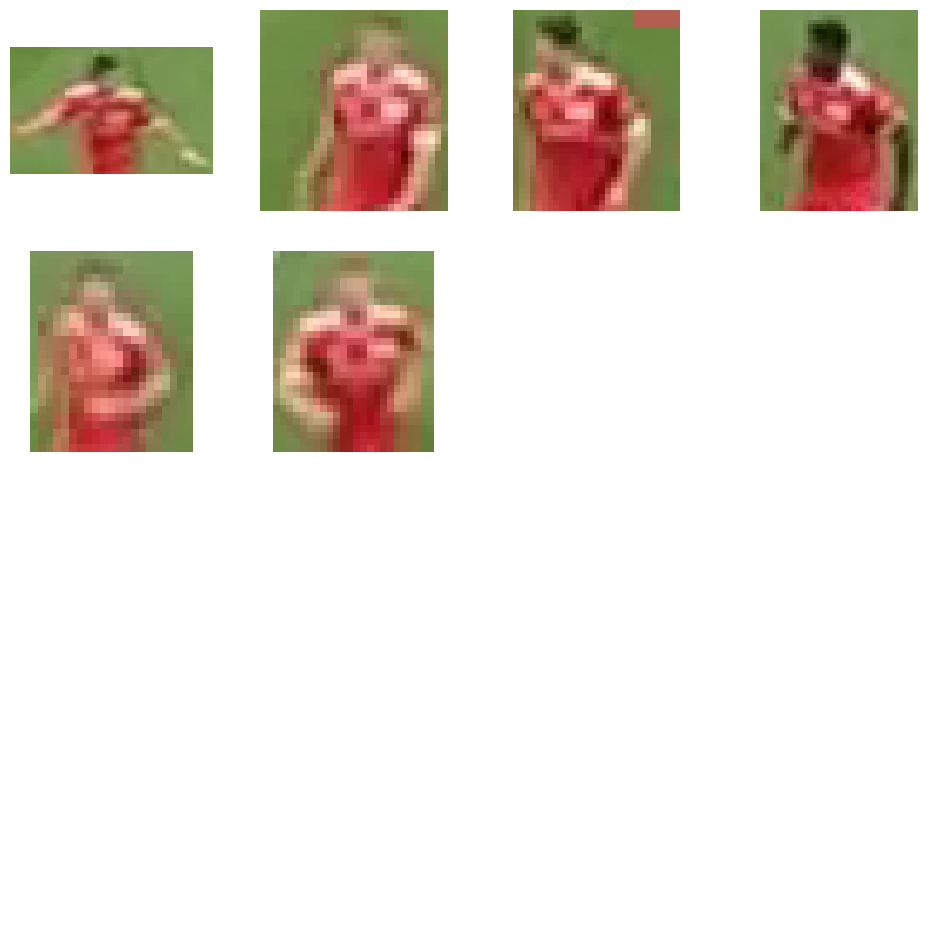

In [ ]:
team_1 = [
    crop
    for crop, cluster
    in zip(players_top_half_crops, team_ids)
    if cluster == 1
]

sv.plot_images_grid(team_1[:16], grid_size=(4, 4))

We see that kmeans is not perfect and make some mistakes.

Assign Teams for every frame

In [ ]:
# Crear un diccionario para almacenar los IDs de los jugadores y su equipo
player_team_dict = {}

# Inicializar el modelo de KMeans para clasificación de colores en equipos
kmeans2 = KMeans(n_clusters=2, init="k-means++", n_init=10)

# Inicializar listas para almacenar colores de jugadores
all_player_colors = []

all_detections_team_list = []

index = 0
# Procesar los frames para extraer colores y asignar equipos
for frame, detections, ball_detections in zip(
    sv.get_video_frames_generator(source_path=SOURCE_VIDEO_PATH, stride=batch_size),
    all_detections_list,
    ball_detections_list
):
    player_detections = detections[detections.class_id == PLAYER_ID]

    if player_detections is not None and len(player_detections.xyxy) > 0:
        player_ids = player_detections.tracker_id
        player_boxes = player_detections.xyxy

        # Obtener los recortes de jugadores
        players_crops = [sv.crop_image(frame, xyxy) for xyxy in player_boxes]
        players_top_half_crops = [crop[:crop.shape[0] // 2, :] for crop in players_crops if crop.size > 0]

        # Obtener colores de los jugadores
        player_colors = []
        for top_half_crop in players_top_half_crops:
            if top_half_crop.size == 0:
                continue  # Saltar recortes vacíos
            kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(top_half_crop.reshape(-1, 3))
            labels = kmeans.labels_.reshape(top_half_crop.shape[:2])

            # Determinar el color dominante del jugador
            corner_clusters = [
                labels[0, 0], labels[0, -1], labels[-1, 0], labels[-1, -1]
            ]
            non_player_cluster = max(set(corner_clusters), key=corner_clusters.count)
            player_cluster = 1 - non_player_cluster

            player_color = kmeans.cluster_centers_[player_cluster]
            player_colors.append(player_color)

        # Clasificar jugadores en dos equipos usando KMeans si se detectan colores
        if len(player_colors) > 1:
            kmeans2.fit(player_colors)
            player_colors_labels = kmeans2.predict(player_colors)

            # Mapear cada jugador a su equipo basado en el ID del tracker
            player_class_ids = []
            for player_id, color_label in zip(player_ids, player_colors_labels):
                if player_id not in player_team_dict:
                    player_team_dict[player_id] = color_label
                player_class_ids.append(player_team_dict[player_id])

            # Reflejar el equipo asignado en player_detections.class_id
            player_detections.class_id = np.array(player_class_ids)

            #print(player_detections.class_id)
        else:
            print("No player colors detected for this frame.")
    else:
        # Si no hay detecciones de jugadores, asignar class_id vacío
        player_detections.class_id = np.empty((0,), dtype=int)

    goalkeeper_detections = detections[detections.class_id == GOALKEEPER_ID]

    # Assign team IDs to goalkeepers
    goalkeepers_detections.class_id = resolve_goalkeepers_team_id(players_detections, goalkeepers_detections)

    referee_detections = detections[detections.class_id == REFEREE_ID]

    all_detections_team = sv.Detections.merge([player_detections, goalkeeper_detections, referee_detections])

    all_detections_team_list.append(all_detections_team)

    index += 1

# Mostrar el diccionario de asignación de equipos para los jugadores
print("Player team assignments:", player_team_dict)

Player team assignments: {1: 0, 3: 1, 4: 1, 5: 0, 6: 0, 7: 0, 8: 1, 9: 0, 10: 0, 11: 1, 12: 0, 14: 1, 15: 0, 16: 1, 17: 1, 18: 1, 19: 0, 20: 1, 22: 1, 23: 1, 13: 1, 28: 0, 29: 0, 30: 0, 33: 1, 34: 1, 35: 1, 37: 0, 38: 0, 40: 1, 41: 0, 42: 1, 43: 1, 45: 0, 46: 1, 48: 0, 49: 0}


In [ ]:
def rgb2hex(r,g,b):
    return "#{:02x}{:02x}{:02x}".format(r,g,b)

In [ ]:
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[0], team_colors_hex[1], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

output_video_frames = []

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

index = 0

for frame in tqdm(frame_generator, desc='Annotating output frames'):
    frame = frame.copy()

    all_detections = all_detections_team_list[index]
    ball_detections = ball_detections_list[index]
    ball_position = interpolated_ball_positions[index].get(1, {}).get('bbox', [])


    if ball_position:
        ball_position = np.array(ball_position).reshape(1, 4)

        if len(ball_detections) > 0:
            ball_detections.xyxy[0] = ball_position[0]
        else:
            ball_detections = sv.Detections(
                xyxy=ball_position,
                confidence=np.array([1.0]),
                class_id=np.array([BALL_ID])
            )
    else:
        ball_detections.xyxy = np.empty((0, 4))

    annotated_frame = annotate_frame(frame, all_detections, ball_detections)

    output_video_frames.append(annotated_frame)
    index += 1

print("")
print("Done!")

Annotating output frames: 750it [00:14, 52.26it/s]


Done!


In [ ]:
save_video(output_video_frames, 'output_video_3.avi')

In [ ]:
!ffmpeg -i output_video_3.avi output_video_3.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Cargar y codificar el video en formato .mp4
video_path = 'output_video_3.mp4'
video = open(video_path, 'rb').read()
video_encoded = b64encode(video).decode('ascii')

# Mostrar el video
HTML(data=f'''
    <video width="640" height="480" controls>
        <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
        Tu navegador no soporta la etiqueta de video.
    </video>
''')

## Pitch Keypoints Detection

We use another trained model to detect the keypoints in the pitch

In [14]:
ROBOFLOW_API_KEY = userdata.get('ROBOFLOW_API_KEY')
FIELD_DETECTION_MODEL_ID = "football-field-detection-f07vi/14"
FIELD_DETECTION_MODEL = get_model(model_id=FIELD_DETECTION_MODEL_ID, api_key=ROBOFLOW_API_KEY)

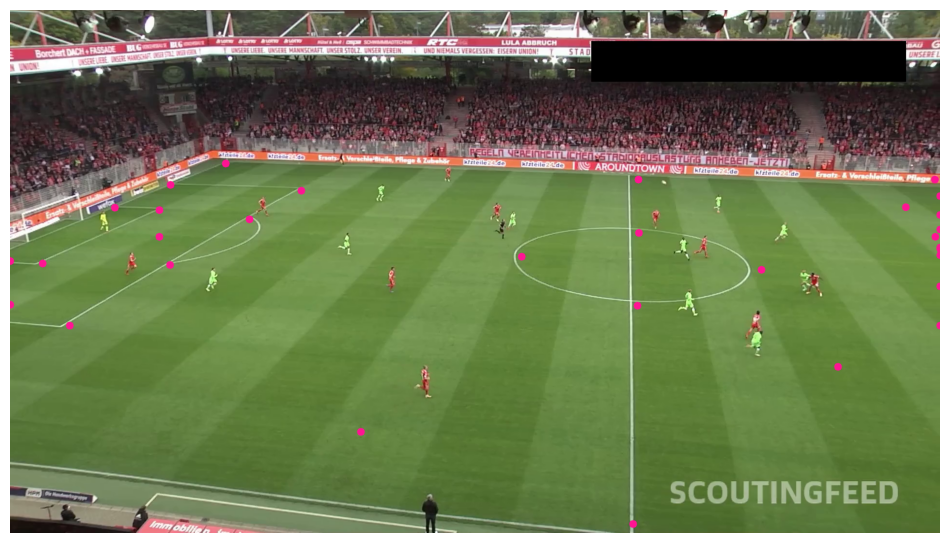

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
key_points = sv.KeyPoints.from_inference(result)

annotated_frame = frame.copy()
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=key_points)

sv.plot_image(annotated_frame)

There are too many keypoints detected, we will remove the ones with lower confidence.

### Remove low confidence keypoints

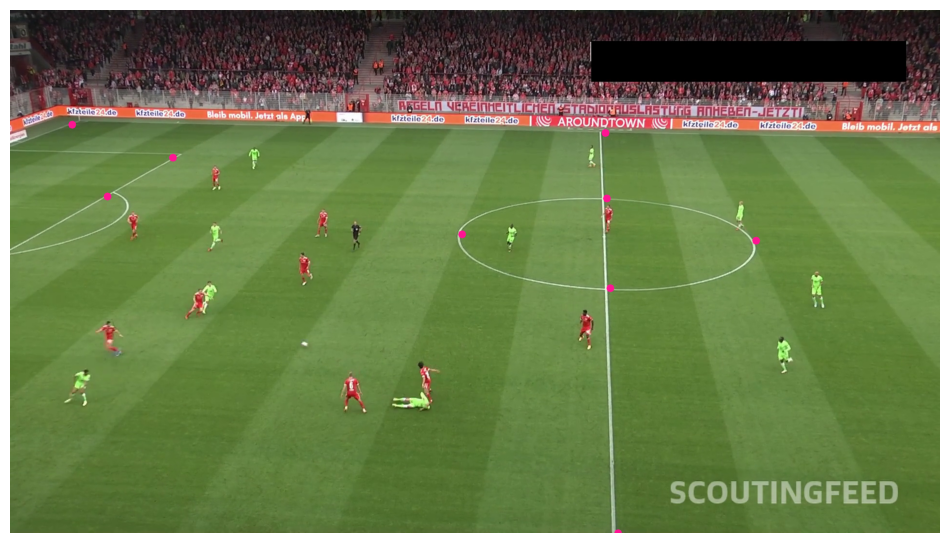

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
key_points = sv.KeyPoints.from_inference(result)

filter = key_points.confidence[0] > 0.5
frame_reference_points = key_points.xy[0][filter]
frame_reference_key_points = sv.KeyPoints(
    xy=frame_reference_points[np.newaxis, ...])

annotated_frame = frame.copy()
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_reference_key_points)

sv.plot_image(annotated_frame)

### Project Video Pitch to 2D Pitch

We will use the Roboflow/sports repository because it has some useful functions to draw the pitch.

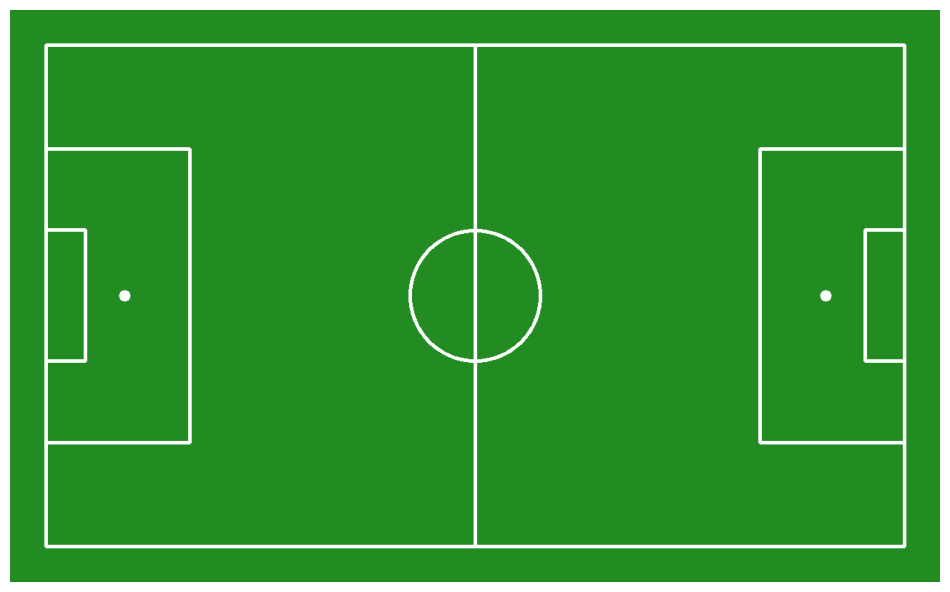

In [55]:
CONFIG = SoccerPitchConfiguration()

annotated_frame = draw_pitch(CONFIG)

sv.plot_image(annotated_frame)

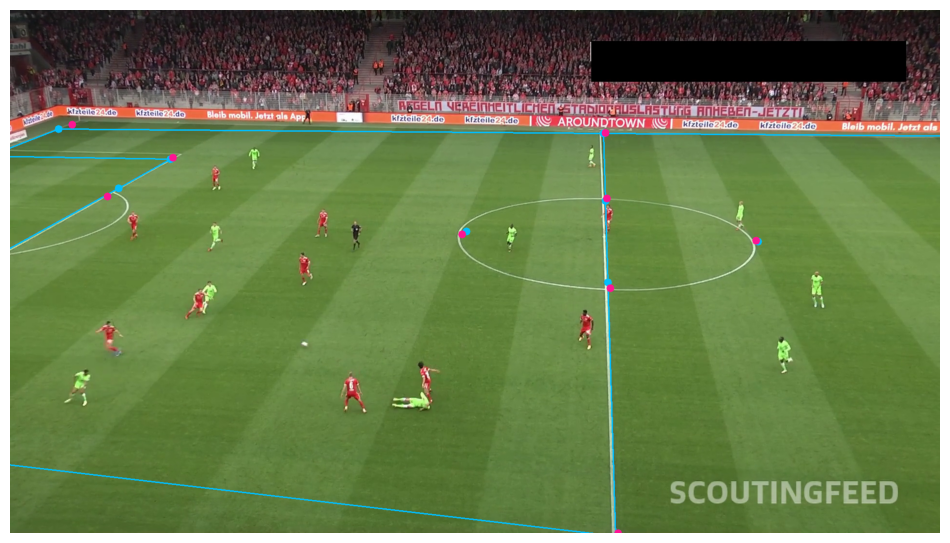

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"

edge_annotator = sv.EdgeAnnotator(
    color=sv.Color.from_hex('#00BFFF'),
    thickness=2, edges=CONFIG.edges)
vertex_annotator = sv.VertexAnnotator(
    color=sv.Color.from_hex('#FF1493'),
    radius=8)
vertex_annotator_2 = sv.VertexAnnotator(
    color=sv.Color.from_hex('#00BFFF'),
    radius=8)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH, start=200)
frame = next(frame_generator)

result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
key_points = sv.KeyPoints.from_inference(result)

filter = key_points.confidence[0] > 0.5
frame_reference_points = key_points.xy[0][filter]
frame_reference_key_points = sv.KeyPoints(
    xy=frame_reference_points[np.newaxis, ...])


# Get pitch reference points based on the configuration and filter
pitch_reference_points = np.array(CONFIG.vertices)[filter]

# Initialize view transformer with source and target points
transformer = ViewTransformer(
    source=pitch_reference_points,
    target=frame_reference_points
)

# Transform all pitch points to frame points
pitch_all_points = np.array(CONFIG.vertices)
frame_all_points = transformer.transform_points(points=pitch_all_points)

# Create key points for all transformed frame points
frame_all_key_points = sv.KeyPoints(xy=frame_all_points[np.newaxis, ...])

annotated_frame = frame.copy()
annotated_frame = edge_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_all_key_points)
annotated_frame = vertex_annotator_2.annotate(
    scene=annotated_frame,
    key_points=frame_all_key_points)
annotated_frame = vertex_annotator.annotate(
    scene=annotated_frame,
    key_points=frame_reference_key_points)

sv.plot_image(annotated_frame)

### Project ball, Players and Referees

In [ ]:
crops = []

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2
STRIDE = 30

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)


for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    players_detections = detections[detections.class_id == PLAYER_ID]
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
    crops += players_crops


# For better accuracy we'll use the TeamClassifier from roboflow/sports repository
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)

collecting crops: 25it [00:21,  1.15it/s]
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/813M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/368 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/711 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/798k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/409 [00:00<?, ?B/s]

Embedding extraction: 18it [00:13,  1.37it/s]


In [ ]:
team_colors_hex = team_color_detection(players_detections, crops)

team_colors_hex

['#c7d794', '#b26655']

Embedding extraction: 1it [00:00,  3.40it/s]


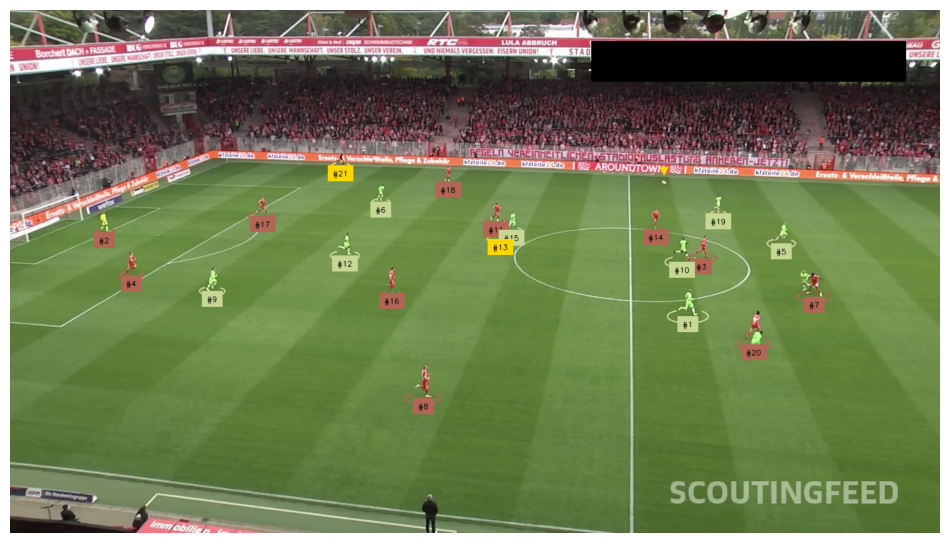

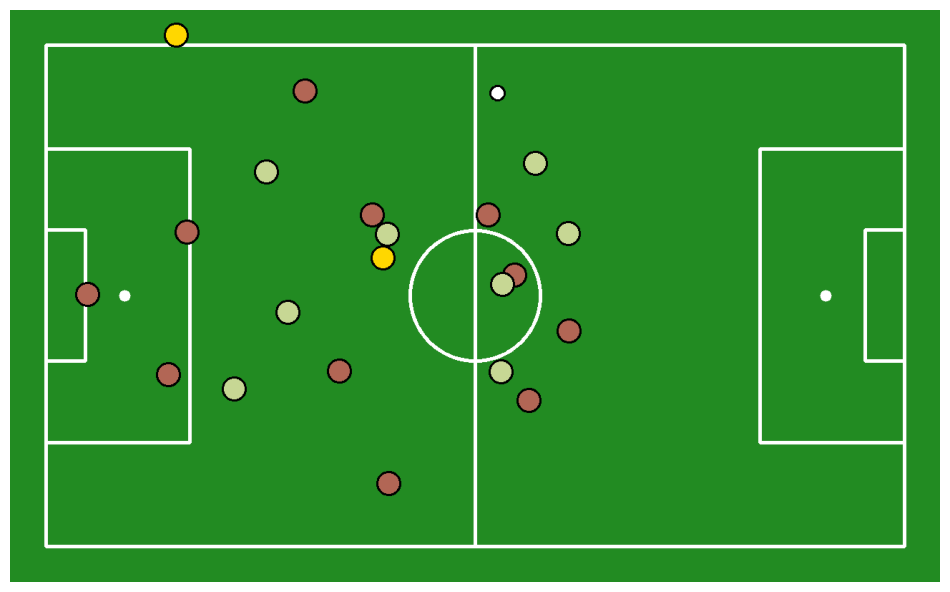

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

tracker = sv.ByteTrack()
tracker.reset()

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# ball, goalkeeper, player, referee detection
result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

# team assignment
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_detections.class_id = team_classifier.predict(players_crops)

goalkeepers_detections.class_id = resolve_goalkeepers_team_id(
    players_detections, goalkeepers_detections)

referees_detections.class_id -= 1

all_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections, referees_detections])

# frame visualization
labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

all_detections.class_id = all_detections.class_id.astype(int)

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections,
    labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame,
    detections=ball_detections)

sv.plot_image(annotated_frame)

players_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections
])

# detect pitch key points
result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
key_points = sv.KeyPoints.from_inference(result)

# project ball, players and referies on pitch
filter = key_points.confidence[0] > 0.5
frame_reference_points = key_points.xy[0][filter]
pitch_reference_points = np.array(CONFIG.vertices)[filter]

transformer = ViewTransformer(
    source=frame_reference_points,
    target=pitch_reference_points
)

frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

players_xy = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_players_xy = transformer.transform_points(points=players_xy)

referees_xy = referees_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_referees_xy = transformer.transform_points(points=referees_xy)

annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_ball_xy,
    face_color=sv.Color.WHITE,
    edge_color=sv.Color.BLACK,
    radius=10,
    pitch=annotated_frame)
annotated_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_players_xy[players_detections.class_id == 0],
    face_color=sv.Color.from_hex(team_colors_hex[1]),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=annotated_frame)
annotated_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_players_xy[players_detections.class_id == 1],
    face_color=sv.Color.from_hex(team_colors_hex[0]),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=annotated_frame)
annotated_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_referees_xy,
    face_color=sv.Color.from_hex('FFD700'),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)


Include the pitch in the frame

Embedding extraction: 1it [00:00,  3.14it/s]


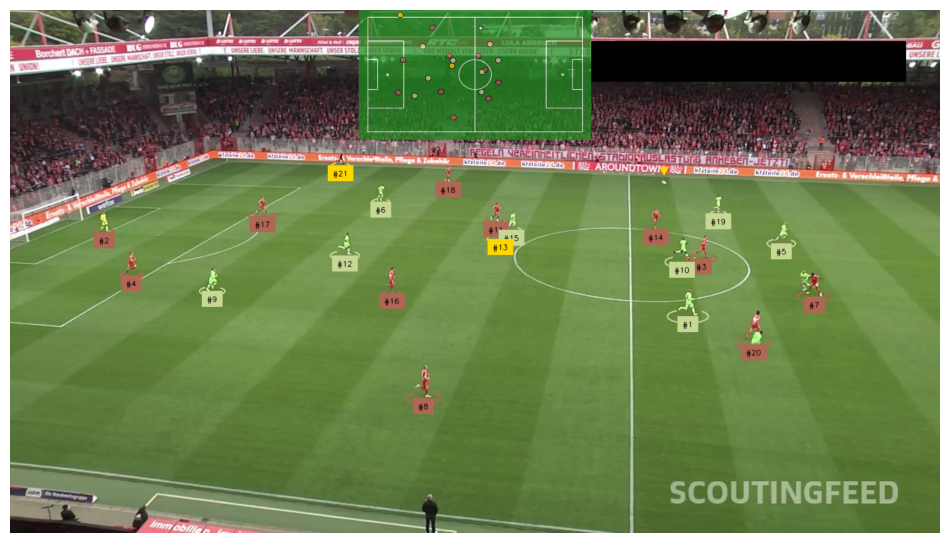

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

# Configuración de los anotadores
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

# Inicialización del tracker
tracker = sv.ByteTrack()
tracker.reset()

# Obtención del primer frame del video
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# Detección de objetos (balón, portero, jugador, árbitro)
result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
detections = sv.Detections.from_inference(result)

# Procesamiento de las detecciones
ball_detections = detections[detections.class_id == BALL_ID]
ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

all_detections = detections[detections.class_id != BALL_ID]
all_detections = all_detections.with_nms(threshold=0.5, class_agnostic=True)
all_detections = tracker.update_with_detections(detections=all_detections)

goalkeepers_detections = all_detections[all_detections.class_id == GOALKEEPER_ID]
players_detections = all_detections[all_detections.class_id == PLAYER_ID]
referees_detections = all_detections[all_detections.class_id == REFEREE_ID]

# Asignación de equipos
players_crops = [sv.crop_image(frame, xyxy) for xyxy in players_detections.xyxy]
players_detections.class_id = team_classifier.predict(players_crops)

goalkeepers_detections.class_id = resolve_goalkeepers_team_id(
    players_detections, goalkeepers_detections)

referees_detections.class_id -= 1

all_detections = sv.Detections.merge([
    players_detections, goalkeepers_detections, referees_detections])

# Visualización de las detecciones en el frame
labels = [
    f"#{tracker_id}"
    for tracker_id
    in all_detections.tracker_id
]

all_detections.class_id = all_detections.class_id.astype(int)

annotated_frame = frame.copy()
annotated_frame = ellipse_annotator.annotate(
    scene=annotated_frame,
    detections=all_detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame, detections=all_detections, labels=labels)
annotated_frame = triangle_annotator.annotate(
    scene=annotated_frame, detections=ball_detections)

# Generación del campo de fútbol y detección de puntos clave en el frame
result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
key_points = sv.KeyPoints.from_inference(result)

filter = key_points.confidence[0] > 0.5
frame_reference_points = key_points.xy[0][filter]
pitch_reference_points = np.array(CONFIG.vertices)[filter]

transformer = ViewTransformer(
    source=frame_reference_points,
    target=pitch_reference_points
)

frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

players_xy = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_players_xy = transformer.transform_points(points=players_xy)

referees_xy = referees_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
pitch_referees_xy = transformer.transform_points(points=referees_xy)

# Dibujar el campo de fútbol
pitch_frame = draw_pitch(CONFIG)
pitch_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_ball_xy,
    face_color=sv.Color.WHITE,
    edge_color=sv.Color.BLACK,
    radius=10,
    pitch=pitch_frame)
pitch_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_players_xy[players_detections.class_id == 0],
    face_color=sv.Color.from_hex(team_colors_hex[1]),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=pitch_frame)
pitch_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_players_xy[players_detections.class_id == 1],
    face_color=sv.Color.from_hex(team_colors_hex[0]),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=pitch_frame)
pitch_frame = draw_points_on_pitch(
    config=CONFIG,
    xy=pitch_referees_xy,
    face_color=sv.Color.from_hex('FFD700'),
    edge_color=sv.Color.BLACK,
    radius=16,
    pitch=pitch_frame)

# Redimensionar el campo de fútbol para que sea más pequeño
small_pitch_frame = cv2.resize(pitch_frame, (int(frame.shape[1] * 0.25), int(frame.shape[0] * 0.25)))

# Calcular la posición de la esquina superior izquierda para centrar la imagen en la parte superior
x_offset = (frame.shape[1] - small_pitch_frame.shape[1]) // 2
y_offset = 0  # Mantenerlo en la parte superior

# Convertir el campo de fútbol a semitransparente
alpha = 0.75  # Nivel de transparencia (0.0 totalmente transparente, 1.0 totalmente opaco)
overlay = annotated_frame.copy()

# Superponer el campo de fútbol centrado en la parte superior del frame
overlay[y_offset:y_offset + small_pitch_frame.shape[0], x_offset:x_offset + small_pitch_frame.shape[1]] = small_pitch_frame

# Combinar las imágenes con transparencia
cv2.addWeighted(overlay, alpha, annotated_frame, 1 - alpha, 0, annotated_frame)

# Mostrar la imagen resultante
sv.plot_image(annotated_frame)


## Final Video Result

In [17]:
crops = []

SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
PLAYER_ID = 2
STRIDE = 30

frame_generator = sv.get_video_frames_generator(
    source_path=SOURCE_VIDEO_PATH, stride=STRIDE)

final_players_detections = []

for frame in tqdm(frame_generator, desc='collecting crops'):
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)
    players_detections = detections[detections.class_id == PLAYER_ID]
    players_crops = [sv.crop_image(frame, xyxy) for xyxy in detections.xyxy]
    crops += players_crops
    final_players_detections = players_detections

team_colors_hex = team_color_detection(final_players_detections, crops)
team_colors_hex


collecting crops: 25it [00:20,  1.25it/s]


['#c1d58b', '#a54d41']

In [18]:
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)

The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/813M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/368 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/711 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/798k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/409 [00:00<?, ?B/s]

Embedding extraction: 18it [00:10,  1.73it/s]


In [19]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

In [20]:
# Configuración de los anotadores
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)
triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)

In [21]:
all_detections_list, ball_detections_list = infer_model(SOURCE_VIDEO_PATH)

infering model: 750it [03:38,  3.43it/s]


Done!


In [22]:
ball_positions = []

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

index = 0
for frame in tqdm(frame_generator, desc='storing ball position'):
    frame = frame.copy()

    ball_detections = ball_detections_list[index]

    if len(ball_detections) > 0:
        ball_positions.append({1: {"bbox": ball_detections.xyxy[0].tolist()}})
    else:
        ball_positions.append({1: {"bbox": []}})  # Si no hay detección, almacenar una lista vacía

    index += 1

storing ball position: 750it [00:08, 92.88it/s]


In [23]:
# Interpolación de las posiciones de la pelota
interpolated_ball_positions = interpolate_ball_positions(ball_positions)

In [24]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
GOALKEEPER_ID = 1
PLAYER_ID = 2
REFEREE_ID = 3

# Configuración de los anotadores
ellipse_annotator = sv.EllipseAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_CENTER
)

distance_label_annotator = sv.LabelAnnotator(
    #color=sv.ColorPalette.from_hex([team_colors_hex[1], team_colors_hex[0], '#FFD700']),
    text_color=sv.Color.from_hex('#000000'),
    text_position=sv.Position.BOTTOM_RIGHT
)

triangle_annotator = sv.TriangleAnnotator(
    color=sv.Color.from_hex('#FFD700'),
    base=20, height=17
)




In [15]:
# Diccionario para almacenar las posiciones en el campo del jugador objetivo
player_heatmap_positions = defaultdict(list)

# ID del jugador para generar el mapa de calor
TARGET_PLAYER_ID = 1  # Aquí debes establecer el tracker_id del jugador que te interesa


In [54]:
# Definir IDs
GOALKEEPER_ID = 0
PLAYER_ID = 1
REFEREE_ID = 3

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

output_frames = []

index = 0

# Inicializar diccionarios para almacenar posiciones, distancias y equipos de los jugadores
player_positions = {}
player_distances = {}
player_teams = {}
player_speeds = {}

FRAME_RATE = 24  # 24 fps
TIME_BETWEEN_FRAMES = 1 / FRAME_RATE  # tiempo entre frames en segundos

for frame in tqdm(frame_generator, desc='Generating output frames'):
    goalkeepers_detections = all_detections_list[index][all_detections_list[index].class_id == GOALKEEPER_ID]
    players_detections = all_detections_list[index][all_detections_list[index].class_id == PLAYER_ID]
    referees_detections = all_detections_list[index][all_detections_list[index].class_id == REFEREE_ID]

    # Interpolar posiciones del balón
    ball_detections = ball_detections_list[index]
    ball_position = interpolated_ball_positions[index].get(1, {}).get('bbox', [])

    if ball_position:
        ball_position = np.array(ball_position).reshape(1, 4)
        if len(ball_detections) > 0:
            ball_detections.xyxy[0] = ball_position[0]
        else:
            ball_detections = sv.Detections(
                xyxy=ball_position,
                confidence=np.array([1.0]),
                class_id=np.array([BALL_ID])
            )
    else:
        ball_detections.xyxy = np.empty((0, 4))

    # Asignar equipos solo a nuevos jugadores
    new_players = [tid for tid in players_detections.tracker_id if tid not in player_teams]
    if new_players:
        new_players_detections = players_detections[np.isin(players_detections.tracker_id, new_players)]
        new_players_crops = [sv.crop_image(frame, xyxy) for xyxy in new_players_detections.xyxy]
        new_players_teams = team_classifier.predict(new_players_crops)
        for tid, team in zip(new_players, new_players_teams):
            player_teams[tid] = team

    # Asignar equipos basados en valores almacenados
    players_detections.class_id = np.array([player_teams.get(tid, -1) for tid in players_detections.tracker_id])

    goalkeepers_detections.class_id = resolve_goalkeepers_team_id(
        players_detections, goalkeepers_detections)

    referees_detections.class_id -= 1

    all_detections = sv.Detections.merge([
        players_detections, goalkeepers_detections, referees_detections])

    # Generación del campo de fútbol y detección de puntos clave en el frame
    result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    key_points = sv.KeyPoints.from_inference(result)

    filter = key_points.confidence[0] > 0.5
    frame_reference_points = key_points.xy[0][filter]
    pitch_reference_points = np.array(CONFIG.vertices)[filter]

    transformer = ViewTransformer(
        source=frame_reference_points,
        target=pitch_reference_points
    )

    for i, tracker_id in enumerate(players_detections.tracker_id):
        current_position = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)[i]
        pitch_position = transformer.transform_points(current_position.reshape(1, 2))[0]
        # Guardar la posición del jugador en el diccionario
        player_heatmap_positions[tracker_id].append(pitch_position)

    # Calcular distancias recorridas y velocidad por los jugadores
    for i, tracker_id in enumerate(players_detections.tracker_id):
        current_position = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)[i]
        pitch_position = transformer.transform_points(current_position.reshape(1, 2))[0]

        if tracker_id not in player_positions:
            player_positions[tracker_id] = pitch_position
            player_distances[tracker_id] = 0
            player_speeds[tracker_id] = 0
        else:
            distance = np.linalg.norm(pitch_position - player_positions[tracker_id])
            # Convertir distancia en píxeles a metros
            distance_meters = distance / 100
            player_distances[tracker_id] += distance_meters

            # Calcular velocidad (m/s) y luego convertir a km/h
            speed_m_s = distance_meters / TIME_BETWEEN_FRAMES
            speed_kmh = speed_m_s * 3.6
            player_speeds[tracker_id] = speed_kmh

            player_positions[tracker_id] = pitch_position

    labels = [
        f"#{tracker_id}"
        for tracker_id in all_detections.tracker_id
    ]

    all_detections.class_id = all_detections.class_id.astype(int)

    annotated_frame = frame.copy()
    annotated_frame = ellipse_annotator.annotate(
        scene=annotated_frame,
        detections=all_detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame, detections=all_detections, labels=labels)

    # Añadir anotaciones de distancia recorrida y velocidad para cada jugador
    for i, (tracker_id, xyxy) in enumerate(zip(players_detections.tracker_id, players_detections.xyxy)):
        label_position = (int(xyxy[0]) - 40 , int(xyxy[1]) + 100)  # Posicionar encima de la cabeza del jugador
        cv2.putText(annotated_frame, f"{player_distances[tracker_id]:.2f}m {player_speeds[tracker_id]:.2f}km/h", label_position,
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 2)

    annotated_frame = triangle_annotator.annotate(
        scene=annotated_frame, detections=ball_detections)

    frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

    players_xy = players_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    pitch_players_xy = transformer.transform_points(points=players_xy)

    referees_xy = referees_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    pitch_referees_xy = transformer.transform_points(points=referees_xy)

    # Dibujar el campo de fútbol
    pitch_frame = draw_pitch(CONFIG)
    pitch_frame = draw_points_on_pitch(
        config=CONFIG,
        xy=pitch_ball_xy,
        face_color=sv.Color.WHITE,
        edge_color=sv.Color.BLACK,
        radius=10,
        pitch=pitch_frame)
    pitch_frame = draw_points_on_pitch(
        config=CONFIG,
        xy=pitch_players_xy[players_detections.class_id == 0],
        face_color=sv.Color.from_hex(team_colors_hex[1]),
        edge_color=sv.Color.BLACK,
        radius=16,
        pitch=pitch_frame)
    pitch_frame = draw_points_on_pitch(
        config=CONFIG,
        xy=pitch_players_xy[players_detections.class_id == 1],
        face_color=sv.Color.from_hex(team_colors_hex[0]),
        edge_color=sv.Color.BLACK,
        radius=16,
        pitch=pitch_frame)
    pitch_frame = draw_points_on_pitch(
        config=CONFIG,
        xy=pitch_referees_xy,
        face_color=sv.Color.from_hex('FFD700'),
        edge_color=sv.Color.BLACK,
        radius=16,
        pitch=pitch_frame)

    # Reducir el tamaño del campo de fútbol
    small_pitch_frame = cv2.resize(pitch_frame, (int(frame.shape[1] * 0.25), int(frame.shape[0] * 0.25)))

    # Calcular la posición de la esquina superior izquierda para centrar la imagen en la parte superior
    x_offset = (frame.shape[1] - small_pitch_frame.shape[1]) // 2
    y_offset = 0

    # Superponer el campo de fútbol centrado en la parte superior del frame
    alpha = 0.75
    overlay = annotated_frame.copy()
    overlay[y_offset:y_offset + small_pitch_frame.shape[0], x_offset:x_offset + small_pitch_frame.shape[1]] = small_pitch_frame
    cv2.addWeighted(overlay, alpha, annotated_frame, 1 - alpha, 0, annotated_frame)

    output_frames.append(annotated_frame)
    index += 1


Generating output frames: 0it [00:00, ?it/s]
Embedding extraction: 0it [00:00, ?it/s]
Embedding extraction: 1it [00:00,  2.57it/s]
Generating output frames: 3it [00:08,  1.86s/it]
Embedding extraction: 1it [00:00, 23.42it/s]
Generating output frames: 5it [00:17,  3.03s/it]
Embedding extraction: 1it [00:00, 22.67it/s]
Generating output frames: 12it [00:23,  1.98it/s]
Embedding extraction: 1it [00:00, 30.93it/s]
Generating output frames: 70it [00:32,  8.62it/s]
Embedding extraction: 1it [00:00, 41.02it/s]
Generating output frames: 86it [00:37,  8.67it/s]
Embedding extraction: 1it [00:00, 60.55it/s]
Generating output frames: 151it [00:45,  8.74it/s]
Embedding extraction: 1it [00:00, 47.68it/s]
Generating output frames: 203it [00:54, 10.70it/s]
Embedding extraction: 1it [00:00, 57.99it/s]
Generating output frames: 205it [00:56,  2.42it/s]
Embedding extraction: 1it [00:00, 55.55it/s]
Generating output frames: 221it [01:00,  8.07it/s]
Embedding extraction: 1it [00:00, 41.83it/s]
Generating o

In [52]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def generate_heatmap(positions, config, kernel_size=1001, intensity=50):
    """
    Genera un mapa de calor basado en las posiciones del jugador utilizando un kernel gaussiano.

    :param positions: Lista de arrays con las posiciones (x, y) del jugador.
    :param config: Configuración del campo de fútbol con dimensiones en cm.
    :param kernel_size: Tamaño del kernel gaussiano para suavizar el mapa de calor (debe ser impar y positivo).
    :param intensity: Factor de intensidad para cada posición, controla el "ancho" del trazo.
    :return: Mapa de calor como una imagen.
    """
    # Verificar que el tamaño del kernel sea impar y positivo
    if kernel_size % 2 == 0:
        kernel_size += 1
    if kernel_size <= 0:
        kernel_size = 3  # Mínimo tamaño del kernel que es impar y positivo

    # Obtener las dimensiones del campo en cm
    pitch_width = config.width
    pitch_length = config.length

    # Crear una imagen en blanco con las dimensiones del campo
    heatmap_img = np.zeros((pitch_length, pitch_width), dtype=np.float32)

    # Convertir las posiciones en índices de la imagen
    for pos in positions:
        x = int(pitch_length - pos[0])  # Posición en la longitud del campo (eje X)
        y = int(pos[1])  # Posición en el ancho del campo (eje Y invertido)

        # Aumentar la intensidad en la posición correspondiente
        if 0 <= x < pitch_length and 0 <= y < pitch_width:
            heatmap_img[x, y] += intensity  # Aumentar la intensidad

    # Suavizar el mapa de calor usando un filtro gaussiano
    heatmap_img = cv2.GaussianBlur(heatmap_img, (kernel_size, kernel_size), 0)

    # Normalizar la imagen para que los valores estén entre 0 y 255
    heatmap_img = cv2.normalize(heatmap_img, None, 0, 255, cv2.NORM_MINMAX)
    heatmap_img = np.uint8(heatmap_img)

    # Aplicar un colormap para mejor visualización
    heatmap_img = cv2.applyColorMap(heatmap_img, cv2.COLORMAP_JET)

    # Rotar la imagen 90 grados para alinearla correctamente con el campo de fútbol
    heatmap_img = cv2.rotate(heatmap_img, cv2.ROTATE_90_CLOCKWISE)

    return heatmap_img


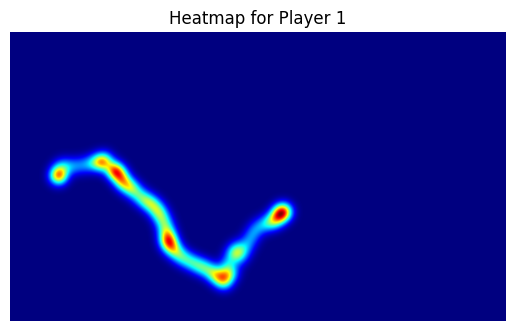

In [61]:
# Generar el mapa de calor
player_positions = player_heatmap_positions[TARGET_PLAYER_ID]  # Reemplaza TARGET_PLAYER_ID con el ID del jugador que te interese
player_heatmap = generate_heatmap(player_positions, CONFIG)

# Guardar el mapa de calor como una imagen
heatmap_image_path = 'player_heatmap.png'
cv2.imwrite(heatmap_image_path, player_heatmap)

# Opcional: Mostrar el mapa de calor usando matplotlib
plt.imshow(cv2.cvtColor(player_heatmap, cv2.COLOR_BGR2RGB))
plt.title(f'Heatmap for Player {TARGET_PLAYER_ID}')
plt.axis('off')
plt.show()


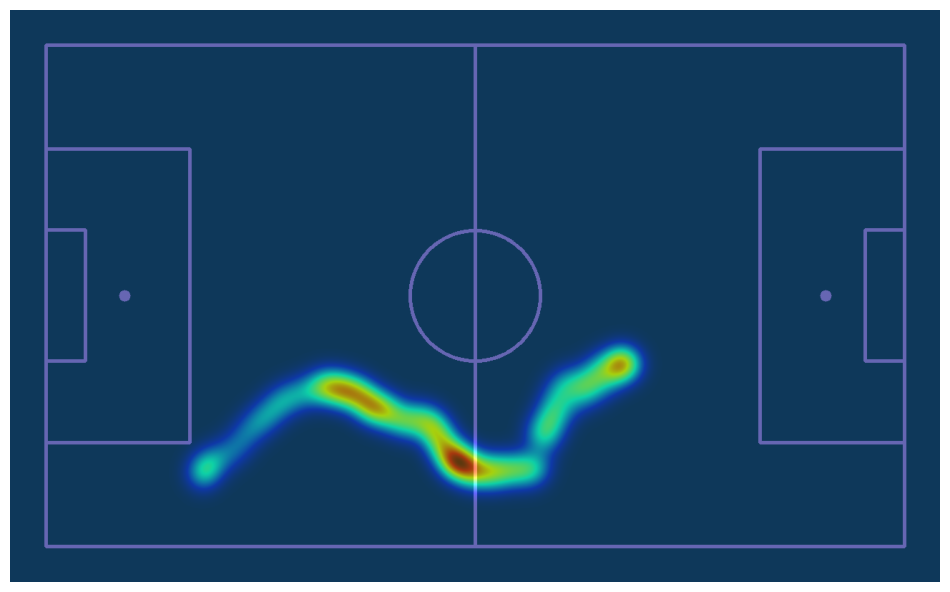

True

In [60]:
pitch = draw_pitch(CONFIG)

# Redimensionar el heatmap para que coincida con las dimensiones del campo de fútbol
scaled_heatmap = cv2.resize(player_heatmap, (pitch.shape[1], pitch.shape[0]))

# Superponer el heatmap en el campo de fútbol
alpha = 0.6  # Controla la transparencia del heatmap
overlay = cv2.addWeighted(scaled_heatmap, alpha, pitch, 1 - alpha, 0)

# Mostrar la imagen final
sv.plot_image(overlay)

# Opcional: Guardar la imagen final
output_image_path = 'pitch_with_heatmap.png'
cv2.imwrite(output_image_path, overlay)

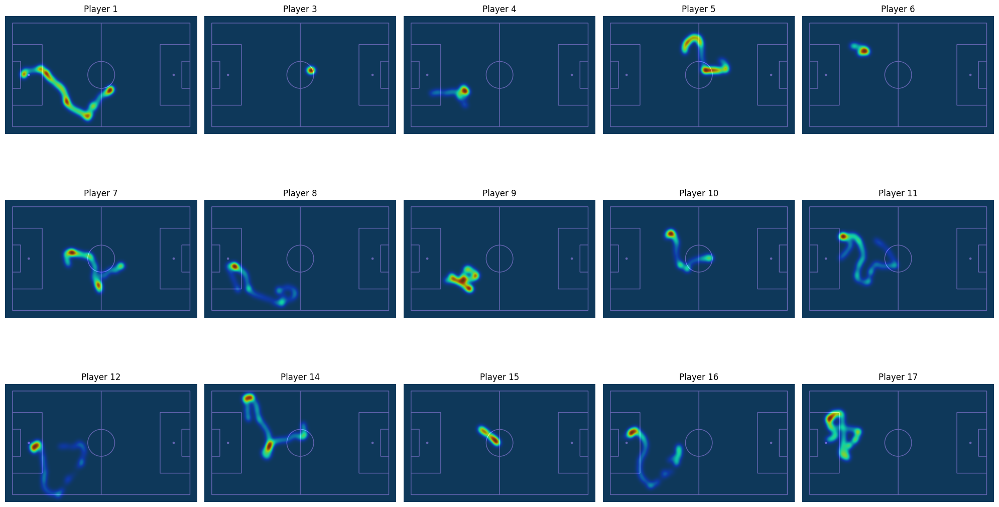

In [66]:
import matplotlib.pyplot as plt

# Obtener los primeros quince IDs de jugadores
player_ids = list(player_heatmap_positions.keys())[:15]

# Crear una figura con 3 filas y 5 columnas
fig, axs = plt.subplots(3, 5, figsize=(20, 12))

# Asegurarse de que axs sea un arreglo plano para facilitar el acceso
axs = axs.ravel()

for i, player_id in enumerate(player_ids):
    # Generar el mapa de calor
    player_positions = player_heatmap_positions[player_id]
    player_heatmap = generate_heatmap(player_positions, CONFIG)

    # Generar la imagen del campo de fútbol
    pitch = draw_pitch(CONFIG)

    # Redimensionar el heatmap para que coincida con las dimensiones del campo de fútbol
    scaled_heatmap = cv2.resize(player_heatmap, (pitch.shape[1], pitch.shape[0]))

    # Superponer el heatmap en el campo de fútbol
    alpha = 0.6  # Controla la transparencia del heatmap
    overlay = cv2.addWeighted(scaled_heatmap, alpha, pitch, 1 - alpha, 0)

    # Mostrar la imagen final en el subplot correspondiente
    axs[i].imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    axs[i].set_title(f'Player {player_id}')
    axs[i].axis('off')  # Ocultar los ejes

# Ajustar el layout para evitar solapamientos
plt.tight_layout()
plt.show()


In [42]:
import cv2
save_video(output_frames, 'final_video.avi')

In [ ]:
!ffmpeg -i final_video.avi final_video.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import HTML
from base64 import b64encode

# Cargar y codificar el video en formato .mp4
video_path = 'final_video.mp4'
video = open(video_path, 'rb').read()
video_encoded = b64encode(video).decode('ascii')

# Mostrar el video
HTML(data=f'''
    <video width="640" height="480" controls>
        <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
        Tu navegador no soporta la etiqueta de video.
    </video>
''')

## ball tracking

In [ ]:
SOURCE_VIDEO_PATH = "/content/121364_0.mp4"
BALL_ID = 0
MAXLEN = 5

video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

path_raw = []
M = deque(maxlen=MAXLEN)

for frame in tqdm(frame_generator, total=video_info.total_frames):

    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    detections = sv.Detections.from_inference(result)

    ball_detections = detections[detections.class_id == BALL_ID]
    ball_detections.xyxy = sv.pad_boxes(xyxy=ball_detections.xyxy, px=10)

    result = FIELD_DETECTION_MODEL.infer(frame, confidence=0.3)[0]
    key_points = sv.KeyPoints.from_inference(result)

    filter = key_points.confidence[0] > 0.5
    frame_reference_points = key_points.xy[0][filter]
    pitch_reference_points = np.array(CONFIG.vertices)[filter]

    transformer = ViewTransformer(
        source=frame_reference_points,
        target=pitch_reference_points
    )
    M.append(transformer.m)
    transformer.m = np.mean(np.array(M), axis=0)

    frame_ball_xy = ball_detections.get_anchors_coordinates(sv.Position.BOTTOM_CENTER)
    pitch_ball_xy = transformer.transform_points(points=frame_ball_xy)

    path_raw.append(pitch_ball_xy)

100%|██████████| 750/750 [04:20<00:00,  2.88it/s]


In [ ]:
path = [
    np.empty((0, 2), dtype=np.float32) if coorinates.shape[0] >= 2 else coorinates
    for coorinates
    in path_raw
]

path = [coorinates.flatten() for coorinates in path]

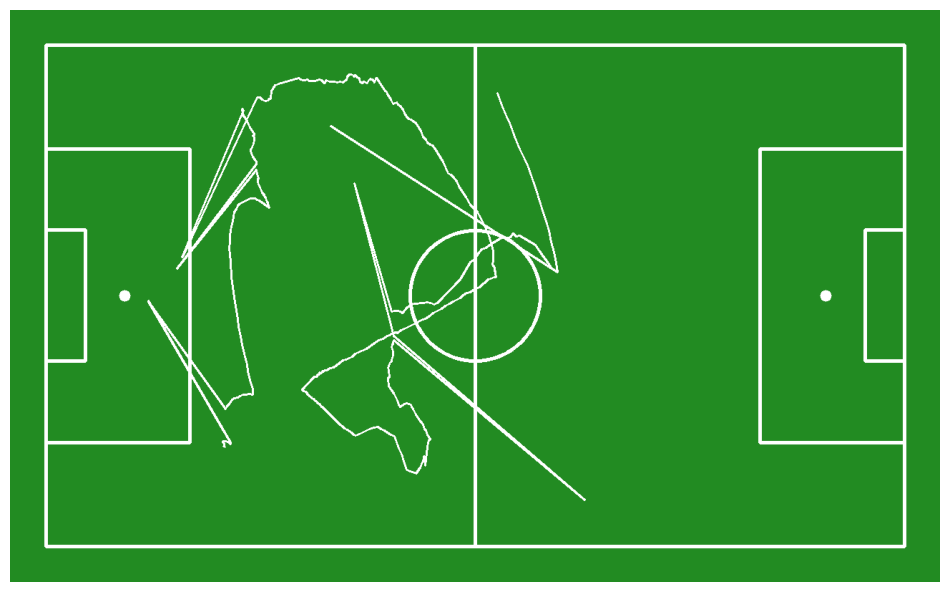

In [ ]:
annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_paths_on_pitch(
    config=CONFIG,
    paths=[path],
    color=sv.Color.WHITE,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)

In [ ]:
def replace_outliers_based_on_distance(
    positions: List[np.ndarray],
    distance_threshold: float
) -> List[np.ndarray]:
    last_valid_position: Union[np.ndarray, None] = None
    cleaned_positions: List[np.ndarray] = []

    for position in positions:
        if len(position) == 0:
            # If the current position is already empty, just add it to the cleaned positions
            cleaned_positions.append(position)
        else:
            if last_valid_position is None:
                # If there's no valid last position, accept the first valid one
                cleaned_positions.append(position)
                last_valid_position = position
            else:
                # Calculate the distance from the last valid position
                distance = np.linalg.norm(position - last_valid_position)
                if distance > distance_threshold:
                    # Replace with empty array if the distance exceeds the threshold
                    cleaned_positions.append(np.array([], dtype=np.float64))
                else:
                    cleaned_positions.append(position)
                    last_valid_position = position

    return cleaned_positions

In [ ]:
MAX_DISTANCE_THRESHOLD = 500

path = replace_outliers_based_on_distance(path, MAX_DISTANCE_THRESHOLD)

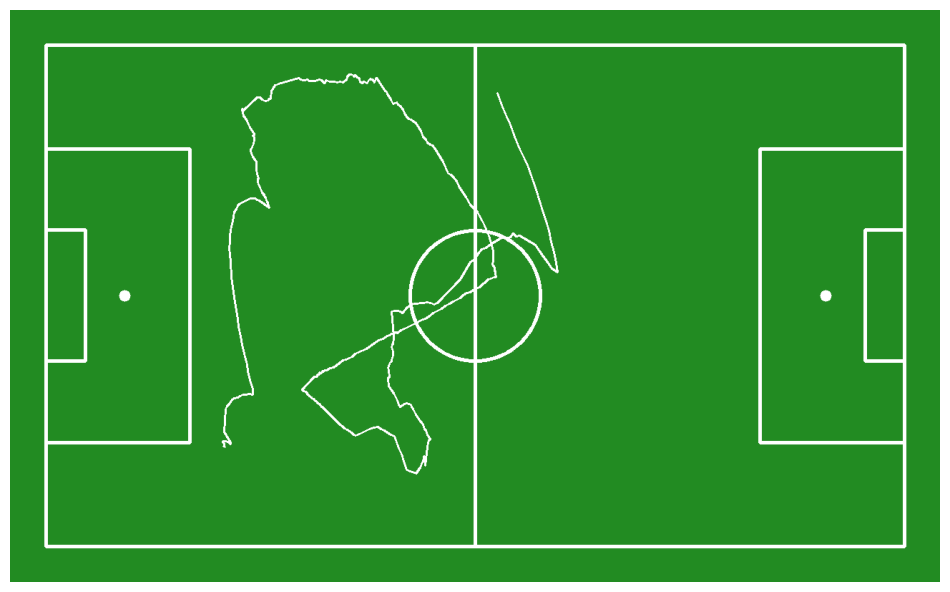

In [ ]:
annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_paths_on_pitch(
    config=CONFIG,
    paths=[path],
    color=sv.Color.WHITE,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)

In [ ]:
def interpolate_empty_positions(path: List[np.ndarray]) -> List[np.ndarray]:
    # Find indices of empty arrays
    empty_indices = [i for i, arr in enumerate(path) if arr.size == 0]

    for idx in empty_indices:
        # Find the previous non-empty array
        prev_idx = max(i for i in range(idx) if path[i].size > 0)

        # Find the next non-empty array (if it exists)
        next_indices = [i for i in range(idx + 1, len(path)) if path[i].size > 0]
        if not next_indices:
            # If no next non-empty array exists, skip interpolation
            continue

        next_idx = min(next_indices)

        # Linear interpolation between the previous and next non-empty arrays
        weight = (idx - prev_idx) / (next_idx - prev_idx)
        interpolated_value = (1 - weight) * path[prev_idx] + weight * path[next_idx]

        # Replace the empty array with the interpolated value
        path[idx] = interpolated_value

    return path

In [ ]:
path = interpolate_empty_positions(path)

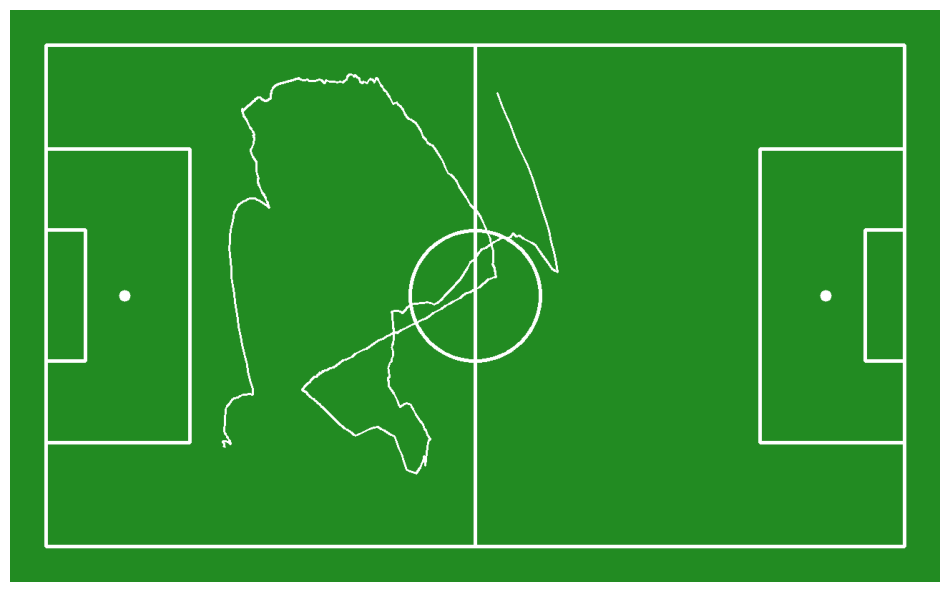

In [ ]:
annotated_frame = draw_pitch(CONFIG)
annotated_frame = draw_paths_on_pitch(
    config=CONFIG,
    paths=[path],
    color=sv.Color.WHITE,
    pitch=annotated_frame)

sv.plot_image(annotated_frame)